In [7]:
import fbm
import matplotlib.pyplot as plt
from fbm.sim.davies_harte import DaviesHarteFBmGenerator
from angiofsde import *
import time

# Paths

In [8]:

n_reps = 5
# Hurst_index = 0.5
n_steps = 5_000
dtau = .1
delta = 1  # Done: review the delta effect over the simulation
mode = 'Simulate'
wall = 50
linear_gradient = LinearGradient(0.1, [0, wall], wall)
constant_gradient = ConstantGradient(0.1)
exponential_gradient = ExponentialGradient(0.1, [0, wall], wall)

figures = {

}
list_H = [0.5, 0.675, 0.85]


time_start = time.time()
warmup_eigenvalues(list_H, n_steps)
for h in list_H:
    A_sim = AngioSimulation(n_reps, h, n_steps, dtau, delta,
                        xa=[0, wall],
                        mode="Simulate",
                        wall=wall, 
                        # only_ht=True, 
                        Grad=exponential_gradient)
    A_sim.simulate(n_jobs=10)
    # if figures['exp'] is None:
    h = str(h).split(".")[1]
    key = f"exp0{h}"
    tray = A_sim.get_trajectories()
    figures[key] = tray
    
time_stop = time.time()
print(f"Simulation time: {time_stop - time_start:.5f} seconds")

Simulation time: 4.62469 seconds


In [9]:

n_reps = 5
# Hurst_index = 0.5
n_steps = 5_000
dtau = .1
delta = 1  # Done: review the delta effect over the simulation
mode = 'Simulate'
wall = 50
linear_gradient = LinearGradient(0.1, [0, wall], wall)
constant_gradient = ConstantGradient(0.1)
exponential_gradient = ExponentialGradient(0.1, [0, wall], wall)

# for h in list_H:
# TODO: Recoletar basura
# TODO: Recoletar basura
time_start = time.time()
list_H = [0.5, 0.675, 0.85]
warmup_eigenvalues(list_H, n_steps)
for h in list_H:
    A_sim = AngioSimulation(n_reps, h, n_steps, dtau, delta,
                        xa=[0, wall],
                        mode="Simulate",
                        wall=wall, 
                        # only_ht=True, 
                        Grad=linear_gradient)
    A_sim.simulate(n_jobs=10)
    # if figures['exp'] is None:
    h = str(h).split(".")[1]
    key = f"lin0{h}"
    tray = A_sim.get_trajectories()
    figures[key] = tray
time_stop = time.time()
print(f"Simulation time: {time_stop - time_start:.5f} seconds")

Simulation time: 1.57397 seconds


In [10]:

n_reps = 5
# Hurst_index = 0.5
n_steps = 5_000
dtau = .1
delta = 1  # Done: review the delta effect over the simulation
mode = 'Simulate'
wall = 50
linear_gradient = LinearGradient(0.1, [0, wall], wall)
constant_gradient = ConstantGradient(0.1)
exponential_gradient = ExponentialGradient(0.1, [0, wall], wall)

# for h in list_H:
# TODO: Recoletar basura
# TODO: Recoletar basura

list_H = [0.5, 0.675, 0.85]

for h in list_H:
    A_sim = AngioSimulation(n_reps, h, n_steps, dtau, delta,
                        xa=[0, wall],
                        mode="Simulate",
                        wall=wall, 
                        # only_ht=True, 
                        Grad=constant_gradient)
    A_sim.simulate(n_jobs=10)
    # if figures['exp'] is None:
    h = str(h).split(".")[1]
    key = f"con0{h}"
    tray = A_sim.get_trajectories()
    figures[key] = tray

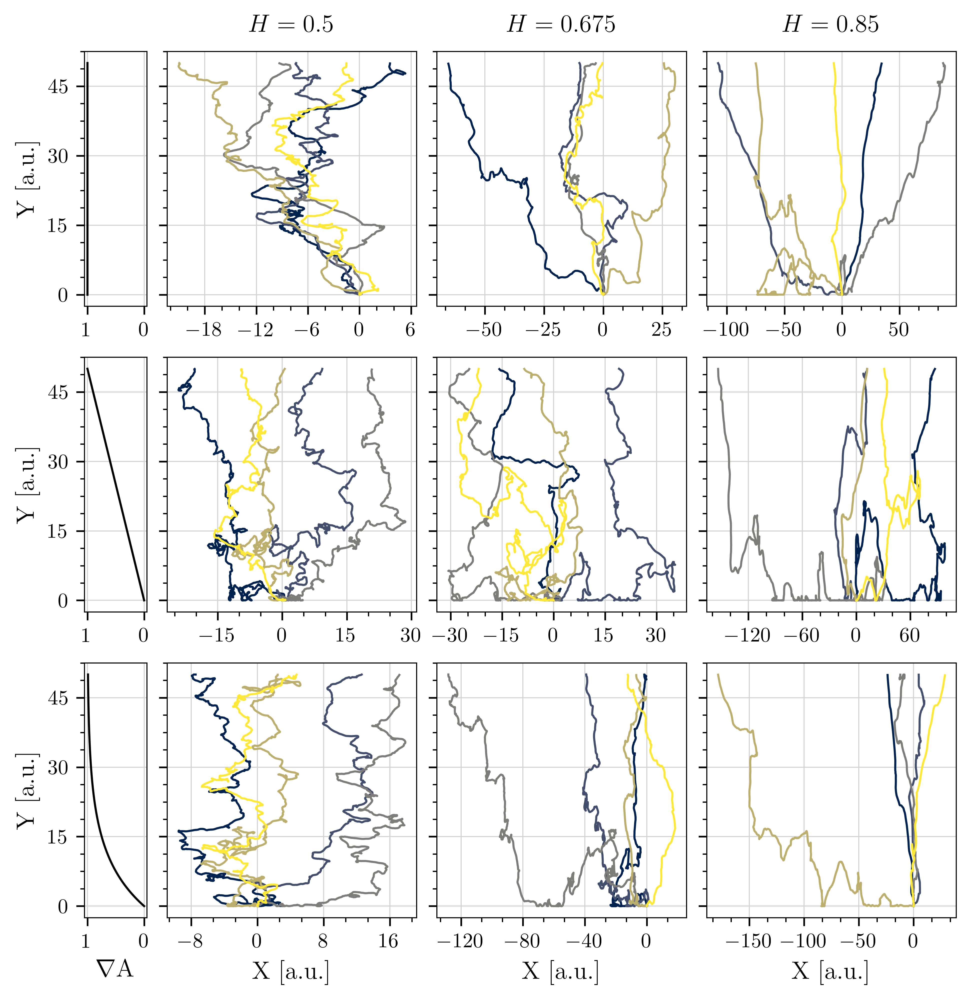

In [146]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})
# for rep in figures['exp05']:
fig, ax = plt.subplot_mosaic(
    [['con_plot', 'con05', 'con0675', 'con085'],
    ['lin_plot', 'lin05', 'lin0675', 'lin085'],
    ['exp_plot', 'exp05', 'exp0675', 'exp085']],
   figsize=(7.5, 7.5),
   dpi = 600,
   gridspec_kw={'hspace': 0.2, 'wspace': 0.1,
                  'height_ratios': [1, 1, 1],
                  'width_ratios': [0.25, 1, 1, 1]},
   sharey=True,
    
)

keys = [ 'con05', 'con0675', 'con085', 'exp05', 'exp0675', 'exp085', 'lin05', 'lin0675', 'lin085']
norm = mcolors.Normalize(vmin=0, vmax= 4)
cmap = plt.cm.cividis
for key in keys:
    for i, rep in enumerate(figures[key]):
        ax[key].plot(rep.T[0], rep.T[1], linewidth = 1, color = cmap(norm(i)), zorder = 3)
        
y = np.linspace(0, 50, 100)

grads_const = [constant_gradient.calculate_gradient([0, x])[1] for x in y]

grads_exp = [exponential_gradient.calculate_gradient([0, x])[1] for x in y]

grads_lin = [linear_gradient.calculate_gradient([0, x])[1] for x in y]

ax['con_plot'].plot(grads_const, y, color = 'black', linewidth = 1)
ax['con_plot'].set_xticks([0, 1.0])
ax['con_plot'].set_xlim([-0.05, 1.05])
# ax['con_plot'].set_xlabel(r'$\nabla \phi$')
ax['con_plot'].set_ylabel(r'Y [a.u.]')
ax['con_plot'].invert_xaxis()
ax['lin_plot'].plot(grads_lin, y, color = 'black', linewidth = 1, )
ax['lin_plot'].set_xticks([0, 1.0])
ax['lin_plot'].set_xlim([-0.05, 1.05])

ax['lin_plot'].set_ylabel(r'Y [a.u.]')
ax['lin_plot'].invert_xaxis()
ax['exp_plot'].plot(grads_exp, y, color = 'black', linewidth = 1)
ax['exp_plot'].set_xticks([0, 1.0])
ax['exp_plot'].set_xlim([-0.05, 1.05])
ax['exp_plot'].set_ylabel(r'Y [a.u.]')
ax['exp_plot'].set_xlabel(r'$\nabla \mathrm{A}$')
ax['exp_plot'].invert_xaxis()

for key in keys:
    ax[key].xaxis.set_major_locator(ticker.MaxNLocator(5))
    ax[key].xaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    ax[key].yaxis.set_major_locator(ticker.MaxNLocator(5))
    ax[key].yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    
for a in ax.values():
    a.grid(which='major', color='lightgray', linestyle='-', linewidth=0.5, zorder = 0)

ax['con05'].annotate(r'$H=0.5$', xy=(0.5, 1.1),
            xycoords='axes fraction', ha='center', va='center',
            fontsize=12, color = 'black', zorder = 4)

ax['con0675'].annotate(r'$H=0.675$', xy=(0.5, 1.1),
            xycoords='axes fraction', ha='center', va='center',
            fontsize=12, color = 'black', zorder = 4)
ax['con085'].annotate(r'$H=0.85$', xy=(0.5, 1.1),
            xycoords='axes fraction', ha='center', va='center',
            fontsize=12, color = 'black', zorder = 4)

ax['exp05'].set_xlabel(r'X [a.u.]')
ax['exp0675'].set_xlabel(r'X [a.u.]')
ax['exp085'].set_xlabel(r'X [a.u.]')



os.makedirs('figures/PathSimulation', exist_ok=True)
fig.savefig('figures/PathSimulation/sprout_simulation.pdf', transparent=True, bbox_inches='tight')


# Empirical Distributions

## Delta = 0.5

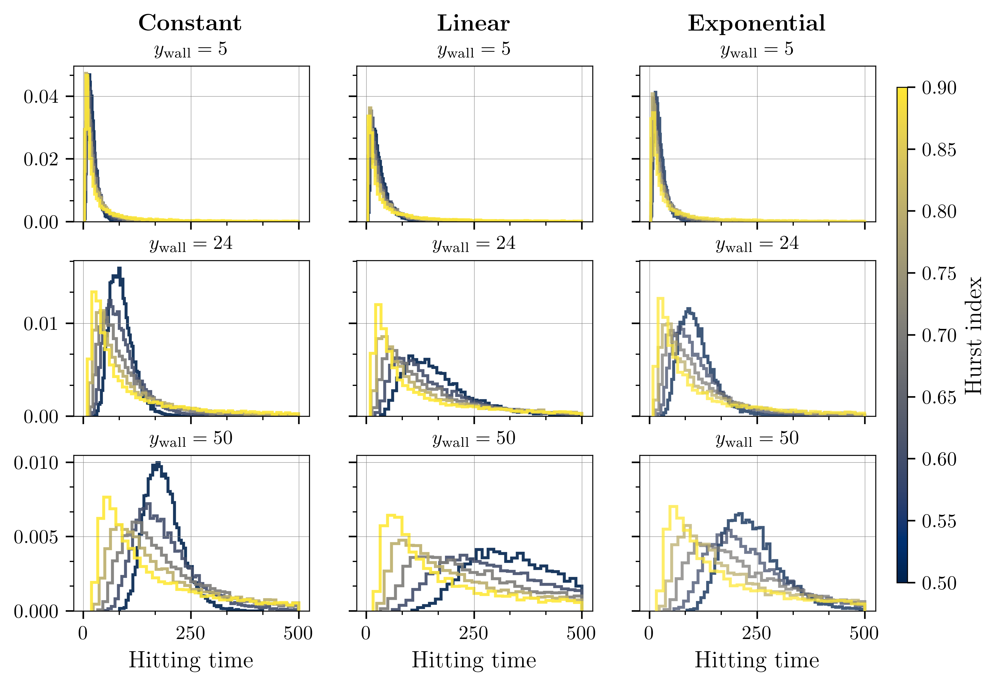

In [267]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Constant6', 'Linear6', 'Exponential6'],
     ['Constant24', 'Linear24', 'Exponential24'],
     ['Constant50', 'Linear50', 'Exponential50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

hurst_to_plot = [0.5, 0.6, 0.7, 0.8, 0.9]

delta_plot = 0.5

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df



h_values = sorted([x for x in list(dict6.keys()) if x != 0])
wall_values = [5, 24, 50]

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Constant6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                         zorder  = 1, histtype='step', linewidth = 1.5)
    
for h in h_values:
    df = dict24[h].dropna().to_numpy()  

    ax['Constant24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Constant50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)
    



#----------- Linear
# 0.5 Consant

folder = 'linear_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

for h in h_values:
    df = dict6[h].dropna().to_numpy()
    ax['Linear6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                       zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict24[h].dropna().to_numpy()
    ax['Linear24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict50[h].dropna().to_numpy()
    ax['Linear50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)
    

#----------- Exponential

folder = 'exponential_h_wall_delta'

# import os 
# import pandas as pd
# import numpy as np
# from os.path import join
# import seaborn as sns
# import matplotlib.pyplot as plt
# import matplotlib.cm as cm
# import matplotlib.colors as mcolors

list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None

        df = pd.read_csv(join(folder, archiv))

        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df
    
dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df
        

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Exponential6'].hist(df, bins='auto', density=True, alpha=0.75, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                            zorder = 3, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict24[h].dropna().to_numpy()

    ax['Exponential24'].hist(df, bins='auto', density=True, alpha=0.75, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)
    



for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Exponential50'].hist(df, bins='auto', density=True, alpha=0.75, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)
    


# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Constant6'].set_xticks([0,250, 500])
ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc6 = ax['Constant6'].get_ylim()
y_limc24 = ax['Constant24'].get_ylim()
y_limc50 = ax['Constant50'].get_ylim()
ax['Constant6'].set_ylim(y_limc6)
ax['Linear6'].set_ylim(y_limc6)
ax['Exponential6'].set_ylim(y_limc6)

ax['Constant24'].set_ylim(y_limc24)
ax['Linear24'].set_ylim(y_limc24)
ax['Exponential24'].set_ylim(y_limc24)

ax['Constant50'].set_ylim(y_limc50)
ax['Linear50'].set_ylim(y_limc50)
ax['Exponential50'].set_ylim(y_limc50)
# eliminate the y axis
ax['Linear6'].set_yticklabels([])
ax['Exponential6'].set_yticklabels([])
ax['Linear24'].set_yticklabels([])
ax['Exponential24'].set_yticklabels([])
ax['Linear50'].set_yticklabels([])
ax['Exponential50'].set_yticklabels([])



# Titles
ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

ax['Constant6'].annotate(
    r'\textbf{Constant}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

ax['Linear6'].annotate(
    r'\textbf{Linear}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

ax['Exponential6'].annotate(
    r'\textbf{Exponential}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/AllDistributionsDelta05.pdf', transparent=True, bbox_inches='tight')

## Delta = 1

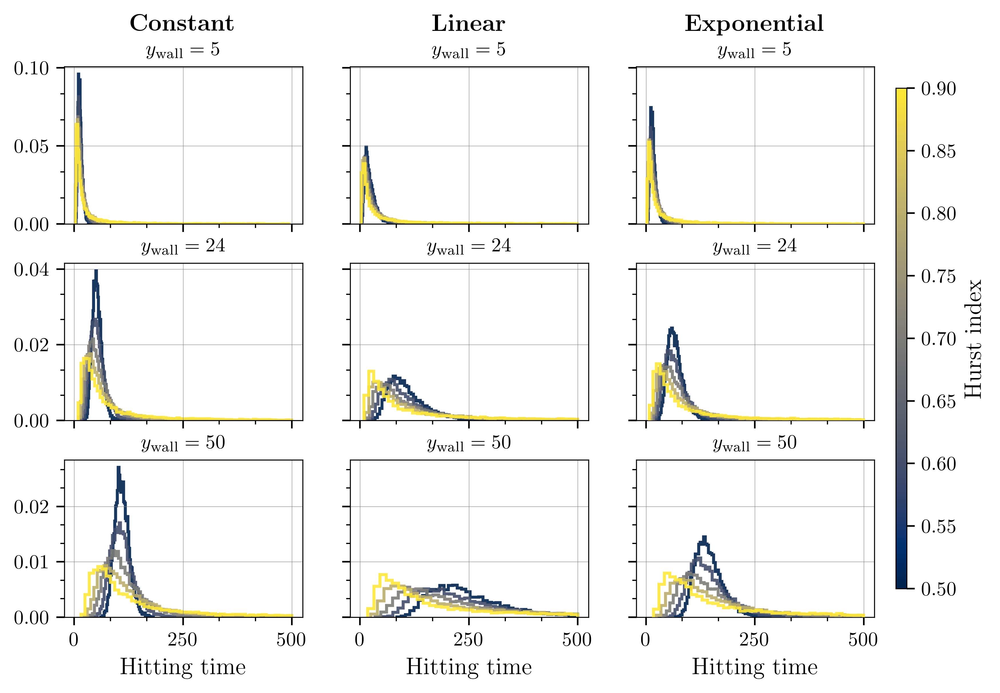

In [268]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Constant6', 'Linear6', 'Exponential6'],
     ['Constant24', 'Linear24', 'Exponential24'],
     ['Constant50', 'Linear50', 'Exponential50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

hurst_to_plot = [0.5, 0.6, 0.7, 0.8, 0.9]

delta_plot = 1

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df



h_values = sorted([x for x in list(dict6.keys()) if x != 0])
wall_values = [5, 24, 50]

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Constant6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                         zorder  = 1, histtype='step', linewidth = 1.5)
    
for h in h_values:
    df = dict24[h].dropna().to_numpy()  

    ax['Constant24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Constant50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)
    



#----------- Linear
# 0.5 Consant

folder = 'linear_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

for h in h_values:
    df = dict6[h].dropna().to_numpy()
    ax['Linear6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                       zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict24[h].dropna().to_numpy()
    ax['Linear24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict50[h].dropna().to_numpy()
    ax['Linear50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)
    

#----------- Exponential

folder = 'exponential_h_wall_delta'

# import os 
# import pandas as pd
# import numpy as np
# from os.path import join
# import seaborn as sns
# import matplotlib.pyplot as plt
# import matplotlib.cm as cm
# import matplotlib.colors as mcolors

list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None

        df = pd.read_csv(join(folder, archiv))

        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df
    
dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df
        

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Exponential6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                            zorder = 3, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict24[h].dropna().to_numpy()

    ax['Exponential24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)
    



for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Exponential50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)
    


# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Constant6'].set_xticks([0,250, 500])
ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc6 = ax['Constant6'].get_ylim()
y_limc24 = ax['Constant24'].get_ylim()
y_limc50 = ax['Constant50'].get_ylim()
ax['Constant6'].set_ylim(y_limc6)
ax['Linear6'].set_ylim(y_limc6)
ax['Exponential6'].set_ylim(y_limc6)

ax['Constant24'].set_ylim(y_limc24)
ax['Linear24'].set_ylim(y_limc24)
ax['Exponential24'].set_ylim(y_limc24)

ax['Constant50'].set_ylim(y_limc50)
ax['Linear50'].set_ylim(y_limc50)
ax['Exponential50'].set_ylim(y_limc50)
# eliminate the y axis
ax['Linear6'].set_yticklabels([])
ax['Exponential6'].set_yticklabels([])
ax['Linear24'].set_yticklabels([])
ax['Exponential24'].set_yticklabels([])
ax['Linear50'].set_yticklabels([])
ax['Exponential50'].set_yticklabels([])



# Titles
ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

ax['Constant6'].annotate(
    r'\textbf{Constant}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

ax['Linear6'].annotate(
    r'\textbf{Linear}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

ax['Exponential6'].annotate(
    r'\textbf{Exponential}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/AllDistributionsDelta1.pdf', transparent=True, bbox_inches='tight')

## Delta = 1.5 -> Needs to be changed to 2 when ready

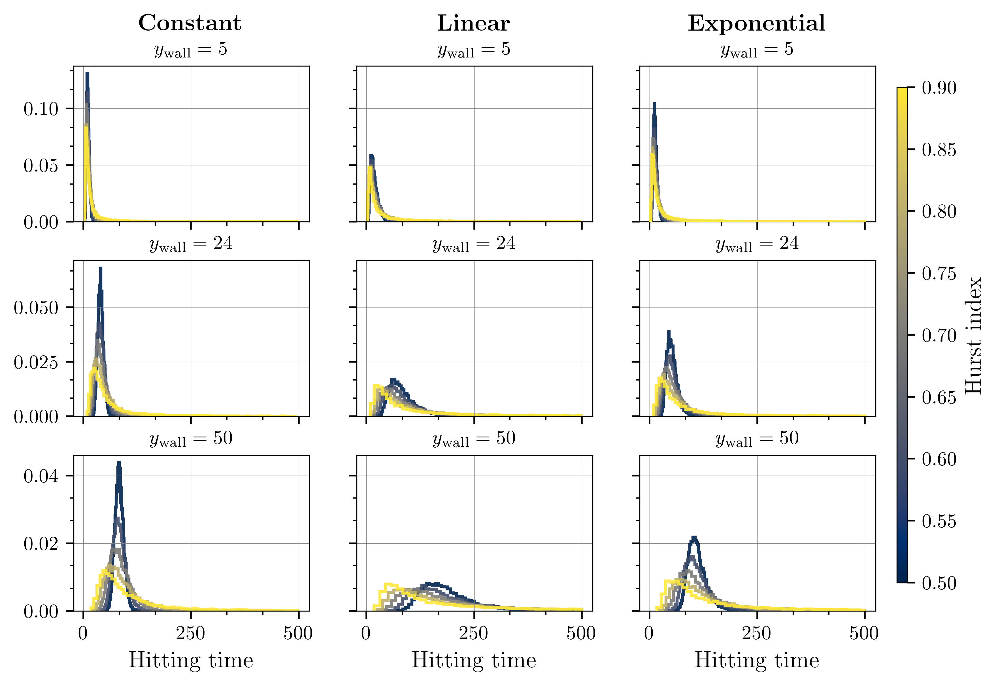

In [269]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Constant6', 'Linear6', 'Exponential6'],
     ['Constant24', 'Linear24', 'Exponential24'],
     ['Constant50', 'Linear50', 'Exponential50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

hurst_to_plot = [0.5, 0.6, 0.7, 0.8, 0.9]

delta_plot = 1.5

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df



h_values = sorted([x for x in list(dict6.keys()) if x != 0])
wall_values = [5, 24, 50]

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Constant6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                         zorder  = 1, histtype='step', linewidth = 1.5)
    
for h in h_values:
    df = dict24[h].dropna().to_numpy()  

    ax['Constant24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Constant50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)
    



#----------- Linear
# 0.5 Consant

folder = 'linear_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

for h in h_values:
    df = dict6[h].dropna().to_numpy()
    ax['Linear6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                       zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict24[h].dropna().to_numpy()
    ax['Linear24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict50[h].dropna().to_numpy()
    ax['Linear50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)
    

#----------- Exponential

folder = 'exponential_h_wall_delta'

# import os 
# import pandas as pd
# import numpy as np
# from os.path import join
# import seaborn as sns
# import matplotlib.pyplot as plt
# import matplotlib.cm as cm
# import matplotlib.colors as mcolors

list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None

        df = pd.read_csv(join(folder, archiv))

        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df
    
dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if h not in hurst_to_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df
        

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Exponential6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                            zorder = 3, histtype='step', linewidth = 1.5)
    

for h in h_values:
    df = dict24[h].dropna().to_numpy()

    ax['Exponential24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)
    



for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Exponential50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)
    


# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Constant6'].set_xticks([0,250, 500])
ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc6 = ax['Constant6'].get_ylim()
y_limc24 = ax['Constant24'].get_ylim()
y_limc50 = ax['Constant50'].get_ylim()
ax['Constant6'].set_ylim(y_limc6)
ax['Linear6'].set_ylim(y_limc6)
ax['Exponential6'].set_ylim(y_limc6)

ax['Constant24'].set_ylim(y_limc24)
ax['Linear24'].set_ylim(y_limc24)
ax['Exponential24'].set_ylim(y_limc24)

ax['Constant50'].set_ylim(y_limc50)
ax['Linear50'].set_ylim(y_limc50)
ax['Exponential50'].set_ylim(y_limc50)
# eliminate the y axis
ax['Linear6'].set_yticklabels([])
ax['Exponential6'].set_yticklabels([])
ax['Linear24'].set_yticklabels([])
ax['Exponential24'].set_yticklabels([])
ax['Linear50'].set_yticklabels([])
ax['Exponential50'].set_yticklabels([])



# Titles
ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

ax['Constant6'].annotate(
    r'\textbf{Constant}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

ax['Linear6'].annotate(
    r'\textbf{Linear}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

ax['Exponential6'].annotate(
    r'\textbf{Exponential}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/AllDistributionsDelta15.pdf', transparent=True, bbox_inches='tight')

# Individual Distributions

## Constant Gradient

### Delta = 0.5

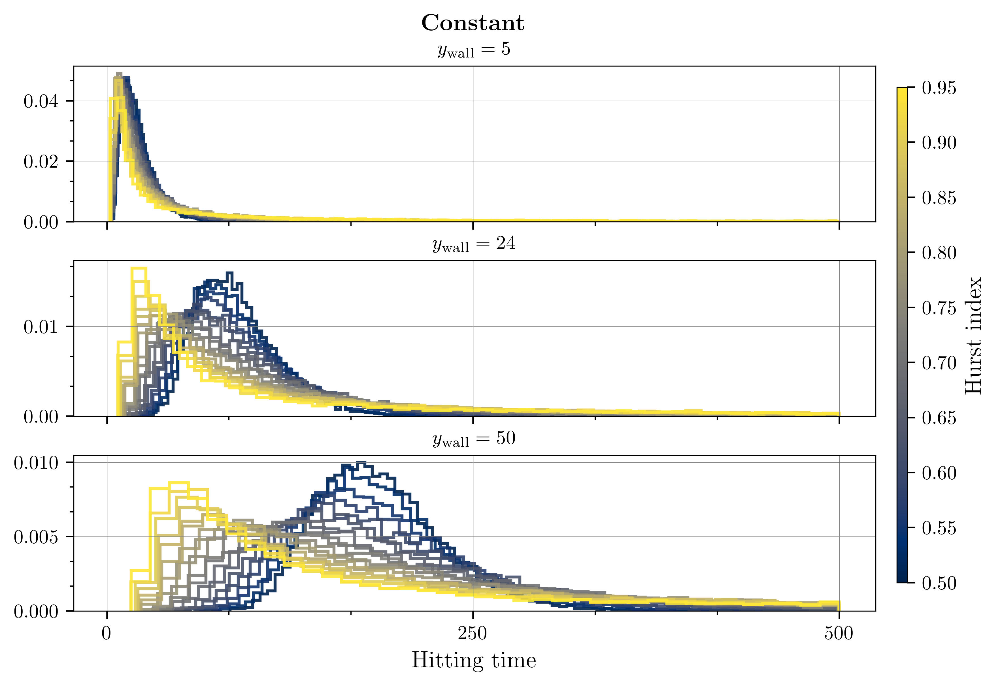

In [270]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Constant6'],
     ['Constant24'],
     ['Constant50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

delta_plot = 0.5

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df



h_values = sorted([x for x in list(dict6.keys()) if x != 0])
wall_values = [5, 24, 50]

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Constant6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                         zorder  = 1, histtype='step', linewidth = 1.5)
    
for h in h_values:
    df = dict24[h].dropna().to_numpy()  

    ax['Constant24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Constant50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)



# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Constant6'].set_xticks([0,250, 500])
ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
# ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
# ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc5 = ax['Constant6'].get_ylim()
y_limc24 = ax['Constant24'].get_ylim()
y_limc50 = ax['Constant50'].get_ylim()
# ax['Constant6'].set_ylim(y_limc5)
# ax['Linear24'].set_ylim(y_limc24)
# ax['Linear50'].set_ylim(y_limc50)
# ax['Linear6'].set_ylim(y_limc5)
# ax['Exponential24'].set_ylim(y_limc24)
# ax['Exponential50'].set_ylim(y_limc50)
# # eliminate the y axis
# ax['Linear6'].set_yticklabels([])
# ax['Exponential6'].set_yticklabels([])
# ax['Linear24'].set_yticklabels([])
# ax['Exponential24'].set_yticklabels([])
# ax['Linear50'].set_yticklabels([])
# ax['Exponential50'].set_yticklabels([])



# Titles
ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

ax['Constant6'].annotate(
    r'\textbf{Constant}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

# ax['Linear6'].annotate(
#     r'\textbf{Linear}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )

# ax['Exponential6'].annotate(
#     r'\textbf{Exponential}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/ConstantDistributionsDelta05.pdf', transparent=True, bbox_inches='tight')

### delta  = 1

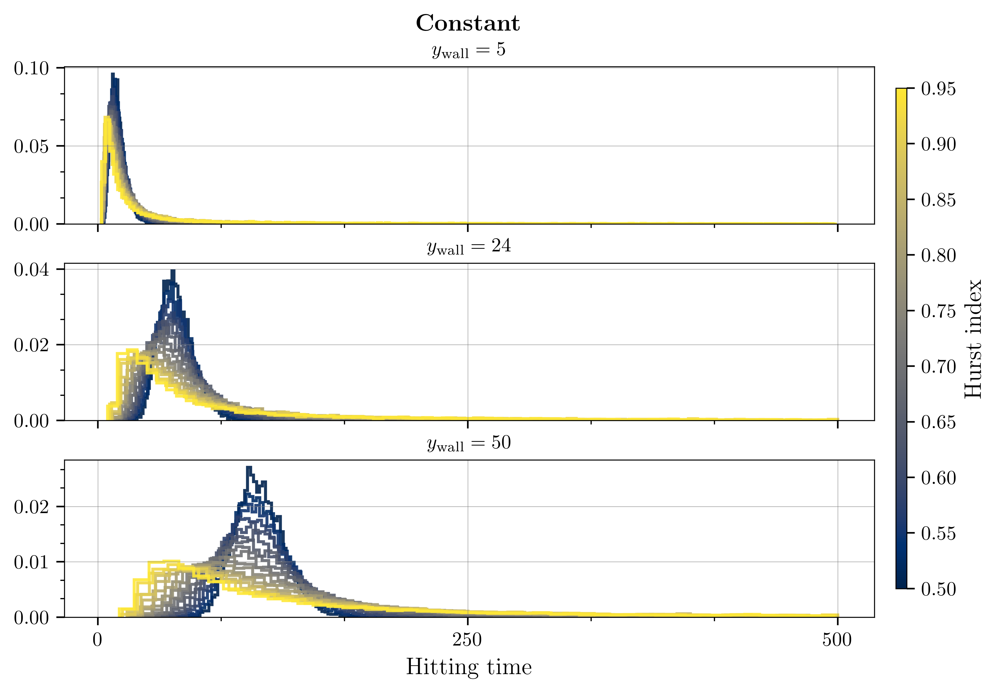

In [271]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Constant6'],
     ['Constant24'],
     ['Constant50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

delta_plot = 1

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df



h_values = sorted([x for x in list(dict6.keys()) if x != 0])
wall_values = [5, 24, 50]

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Constant6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                         zorder  = 1, histtype='step', linewidth = 1.5)
    
for h in h_values:
    df = dict24[h].dropna().to_numpy()  

    ax['Constant24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Constant50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)



# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Constant6'].set_xticks([0,250, 500])
ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
# ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
# ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc5 = ax['Constant6'].get_ylim()
y_limc24 = ax['Constant24'].get_ylim()
y_limc50 = ax['Constant50'].get_ylim()
# ax['Constant6'].set_ylim(y_limc5)
# ax['Linear24'].set_ylim(y_limc24)
# ax['Linear50'].set_ylim(y_limc50)
# ax['Linear6'].set_ylim(y_limc5)
# ax['Exponential24'].set_ylim(y_limc24)
# ax['Exponential50'].set_ylim(y_limc50)
# # eliminate the y axis
# ax['Linear6'].set_yticklabels([])
# ax['Exponential6'].set_yticklabels([])
# ax['Linear24'].set_yticklabels([])
# ax['Exponential24'].set_yticklabels([])
# ax['Linear50'].set_yticklabels([])
# ax['Exponential50'].set_yticklabels([])



# Titles
ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

ax['Constant6'].annotate(
    r'\textbf{Constant}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

# ax['Linear6'].annotate(
#     r'\textbf{Linear}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )

# ax['Exponential6'].annotate(
#     r'\textbf{Exponential}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)

os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/ConstantDistributionsDelta1.pdf', transparent=True, bbox_inches='tight')

### delta  = 1.5

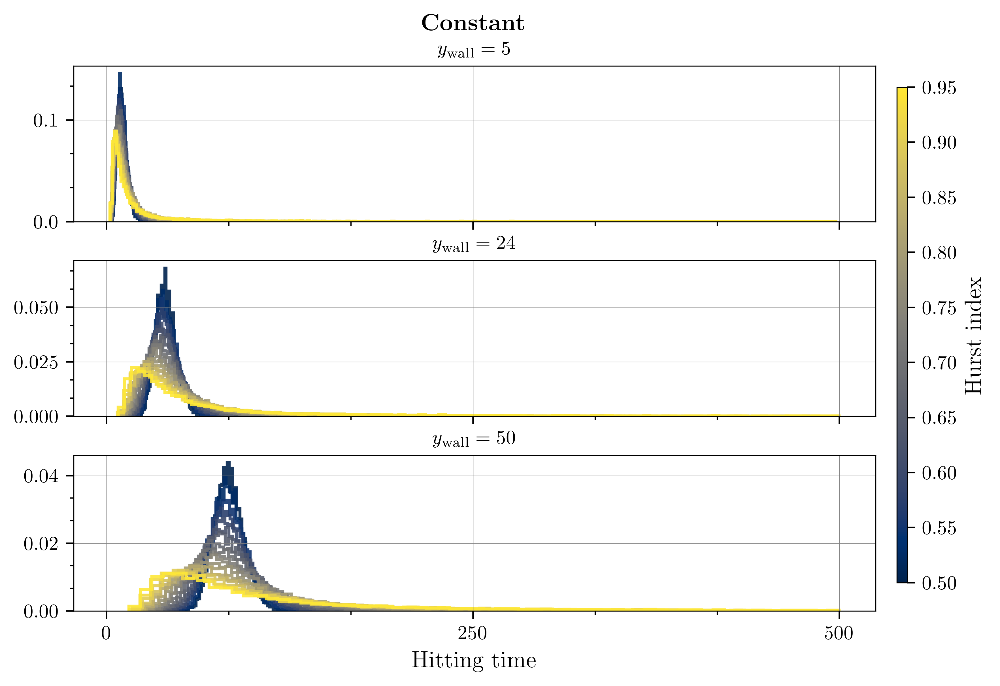

In [272]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Constant6'],
     ['Constant24'],
     ['Constant50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

delta_plot = 1.5

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df



h_values = sorted([x for x in list(dict6.keys()) if x != 0])
wall_values = [5, 24, 50]

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Constant6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                         zorder  = 1, histtype='step', linewidth = 1.5)
    
for h in h_values:
    df = dict24[h].dropna().to_numpy()  

    ax['Constant24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Constant50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step', linewidth = 1.5)



# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Constant6'].set_xticks([0,250, 500])
ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
# ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
# ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc5 = ax['Constant6'].get_ylim()
y_limc24 = ax['Constant24'].get_ylim()
y_limc50 = ax['Constant50'].get_ylim()
# ax['Constant6'].set_ylim(y_limc5)
# ax['Linear24'].set_ylim(y_limc24)
# ax['Linear50'].set_ylim(y_limc50)
# ax['Linear6'].set_ylim(y_limc5)
# ax['Exponential24'].set_ylim(y_limc24)
# ax['Exponential50'].set_ylim(y_limc50)
# # eliminate the y axis
# ax['Linear6'].set_yticklabels([])
# ax['Exponential6'].set_yticklabels([])
# ax['Linear24'].set_yticklabels([])
# ax['Exponential24'].set_yticklabels([])
# ax['Linear50'].set_yticklabels([])
# ax['Exponential50'].set_yticklabels([])



# Titles
ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

ax['Constant6'].annotate(
    r'\textbf{Constant}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

# ax['Linear6'].annotate(
#     r'\textbf{Linear}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )

# ax['Exponential6'].annotate(
#     r'\textbf{Exponential}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
    
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)    
fig.savefig('figures/EmpiricalDistributions/ConstantDistributionsDelta15.pdf', transparent=True, bbox_inches='tight')

## Linear Gradient

### delta = 0.5

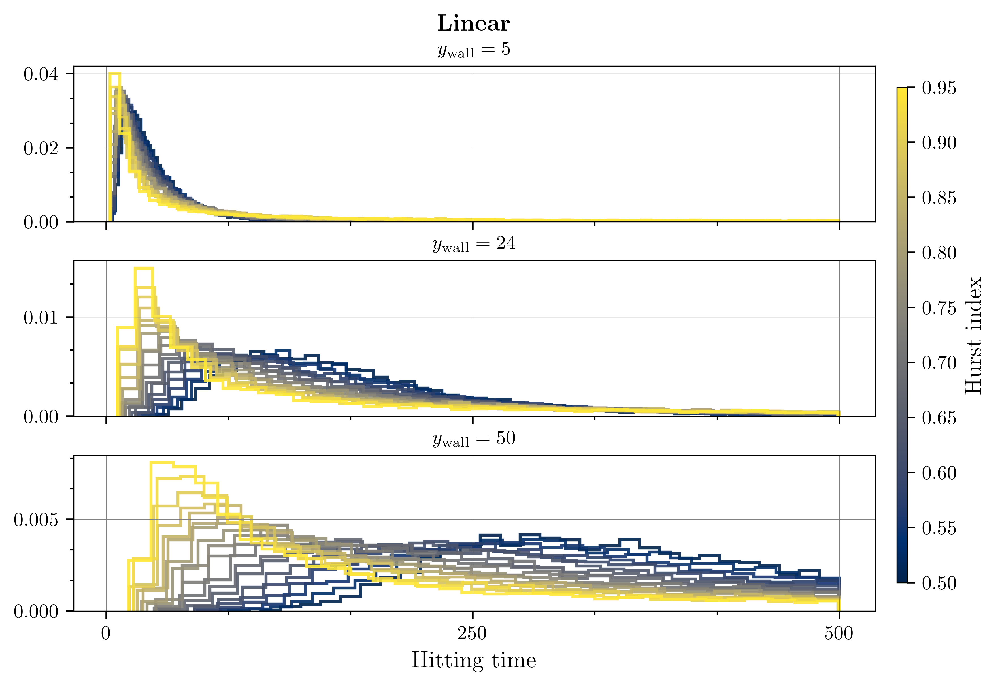

In [273]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Linear6'],
     ['Linear24'],
     ['Linear50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    # width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

delta_plot = 0.5

#----------- Linear
# 0.5 Consant

folder = 'linear_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

for h in h_values:
    df = dict6[h].dropna().to_numpy()
    ax['Linear6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                       zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict24[h].dropna().to_numpy()
    ax['Linear24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict50[h].dropna().to_numpy()
    ax['Linear50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)

# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Linear6'].set_xticks([0,250, 500])
# ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
# ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc5 = ax['Linear6'].get_ylim()
y_limc24 = ax['Linear24'].get_ylim()
y_limc50 = ax['Linear50'].get_ylim()

# eliminate the y axis
# ax['Linear6'].set_yticklabels([])
# ax['Exponential6'].set_yticklabels([])
# ax['Linear24'].set_yticklabels([])
# ax['Exponential24'].set_yticklabels([])
# ax['Linear50'].set_yticklabels([])
# ax['Exponential50'].set_yticklabels([])



# # Titles
# ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

# ax['Constant6'].annotate(
#     r'\textbf{Constant}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )

ax['Linear6'].annotate(
    r'\textbf{Linear}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

# ax['Exponential6'].annotate(
#     r'\textbf{Exponential}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
    
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/LinearDistributionsDelta05.pdf', transparent=True, bbox_inches='tight')

### delta = 1

In [274]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

delta_plot = 1

#----------- Linear
# 0.5 Consant

folder = 'linear_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

for h in h_values:
    df = dict6[h].dropna().to_numpy()
    ax['Linear6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                       zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict24[h].dropna().to_numpy()
    ax['Linear24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict50[h].dropna().to_numpy()
    ax['Linear50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)

# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Linear6'].set_xticks([0,250, 500])
# ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
# ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc5 = ax['Linear6'].get_ylim()
y_limc24 = ax['Linear24'].get_ylim()
y_limc50 = ax['Linear50'].get_ylim()

# eliminate the y axis
# ax['Linear6'].set_yticklabels([])
# ax['Exponential6'].set_yticklabels([])
# ax['Linear24'].set_yticklabels([])
# ax['Exponential24'].set_yticklabels([])
# ax['Linear50'].set_yticklabels([])
# ax['Exponential50'].set_yticklabels([])



# # Titles
# ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

# ax['Constant6'].annotate(
#     r'\textbf{Constant}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )

ax['Linear6'].annotate(
    r'\textbf{Linear}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

# ax['Exponential6'].annotate(
#     r'\textbf{Exponential}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)

os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/LinearDistributionsDelta1.pdf', transparent=True, bbox_inches='tight')

### delta = 1.5

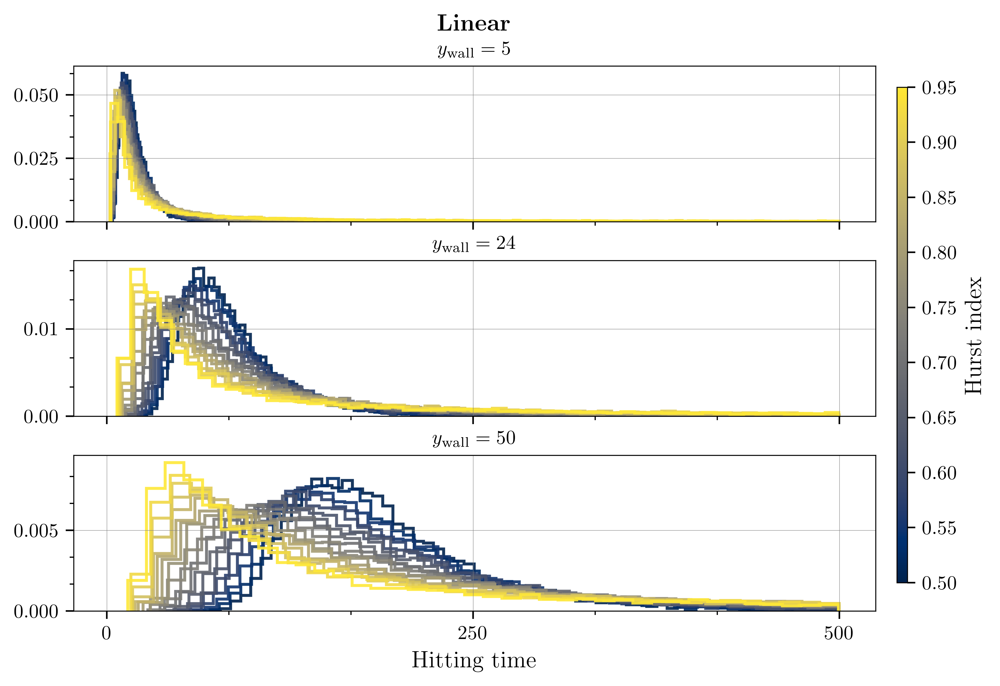

In [275]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Linear6'],
     ['Linear24'],
     ['Linear50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    # width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

delta_plot = 1.5

#----------- Linear
# 0.5 Consant

folder = 'linear_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 6:
        if h not in dict6:
            dict6[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

for h in h_values:
    df = dict6[h].dropna().to_numpy()
    ax['Linear6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                       zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict24[h].dropna().to_numpy()
    ax['Linear24'].hist(df, bins='auto', density=True, alpha=0.9, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict50[h].dropna().to_numpy()
    ax['Linear50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                        zorder = 1, histtype='step', linewidth = 1.5)

# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Linear6'].set_xticks([0,250, 500])
# ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
# ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc5 = ax['Linear6'].get_ylim()
y_limc24 = ax['Linear24'].get_ylim()
y_limc50 = ax['Linear50'].get_ylim()

# eliminate the y axis
# ax['Linear6'].set_yticklabels([])
# ax['Exponential6'].set_yticklabels([])
# ax['Linear24'].set_yticklabels([])
# ax['Exponential24'].set_yticklabels([])
# ax['Linear50'].set_yticklabels([])
# ax['Exponential50'].set_yticklabels([])



# # Titles
# ax['Constant6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Constant24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
ax['Linear6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Linear24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
# ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

# ax['Constant6'].annotate(
#     r'\textbf{Constant}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )

ax['Linear6'].annotate(
    r'\textbf{Linear}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

# ax['Exponential6'].annotate(
#     r'\textbf{Exponential}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
    
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/LinearDistributionsDelta15.pdf', transparent=True, bbox_inches='tight')

## Exponential Gradient

### delta = 0.5

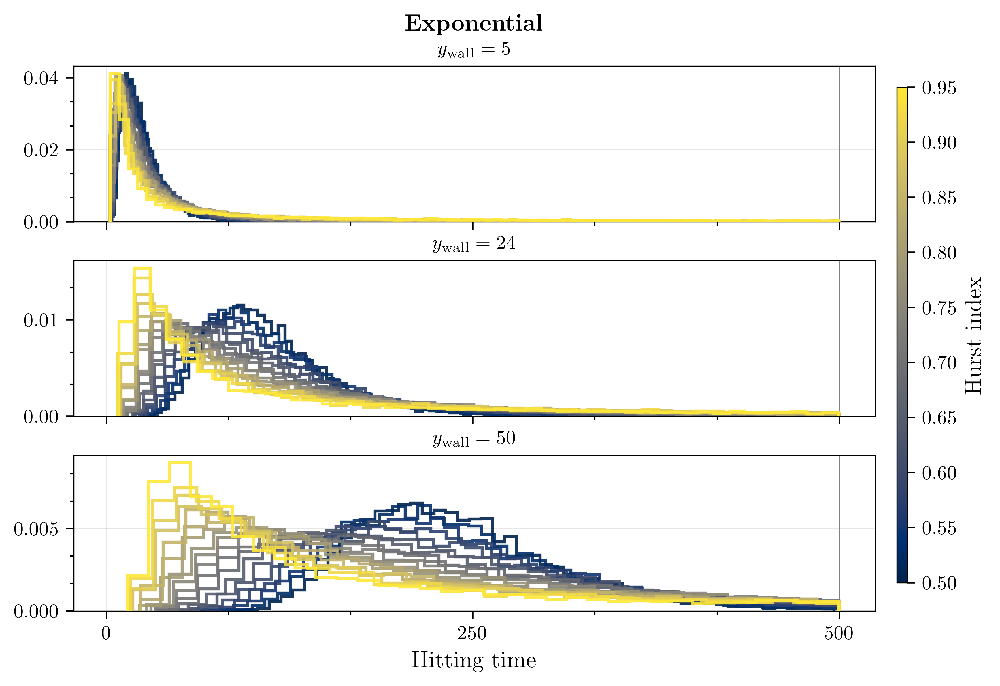

In [276]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Exponential6'],
     ['Exponential24'],
     ['Exponential50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    # width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

delta_plot = 0.5


folder = 'exponential_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    
    if wall == 6:
        if h not in dict6:
            dict6[h] = None

        df = pd.read_csv(join(folder, archiv))

        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df
    
dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df
        

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Exponential6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                            zorder = 3, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict24[h].dropna().to_numpy()

    ax['Exponential24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)



for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Exponential50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)


# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Exponential6'].set_xticks([0,250, 500])
ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)


# Y-axis
y_limc5 = ax['Exponential6'].get_ylim()
y_limc24 = ax['Exponential24'].get_ylim()
y_limc50 = ax['Exponential50'].get_ylim()



# Titles
ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels


ax['Exponential6'].annotate(
    r'\textbf{Exponential}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
    
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)    
fig.savefig('figures/EmpiricalDistributions/ExponentialDistributionsDelta05.pdf', transparent=True, bbox_inches='tight')

### delta = 1

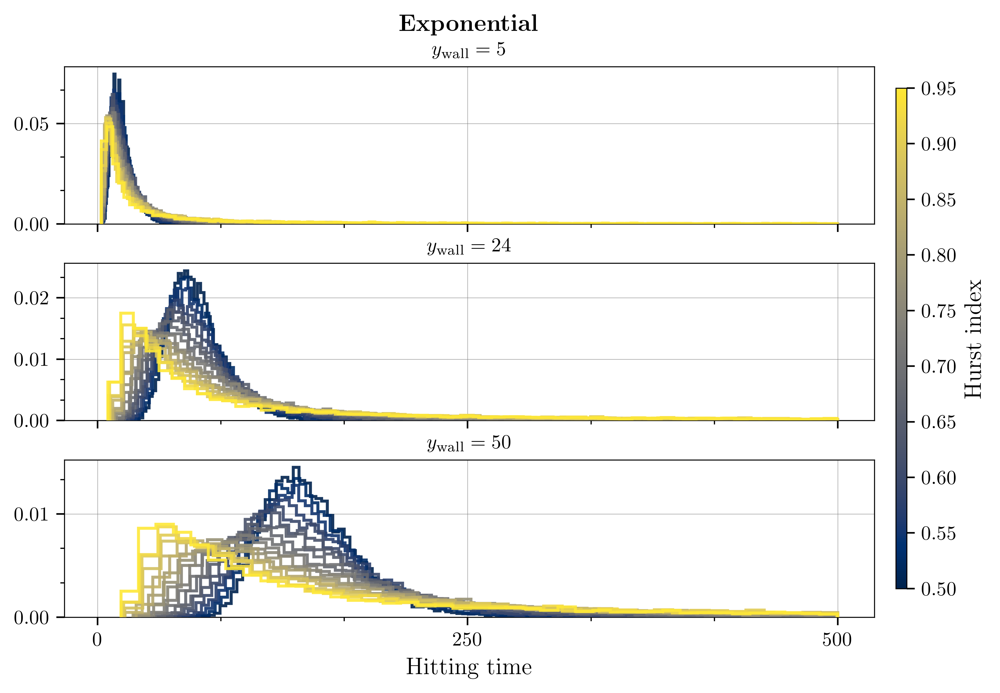

In [277]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Exponential6'],
     ['Exponential24'],
     ['Exponential50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    # width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

delta_plot = 1


folder = 'exponential_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    
    if wall == 6:
        if h not in dict6:
            dict6[h] = None

        df = pd.read_csv(join(folder, archiv))

        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df
    
dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df
        

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Exponential6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                            zorder = 3, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict24[h].dropna().to_numpy()

    ax['Exponential24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)



for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Exponential50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)


# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Exponential6'].set_xticks([0,250, 500])
ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)


# Y-axis
y_limc5 = ax['Exponential6'].get_ylim()
y_limc24 = ax['Exponential24'].get_ylim()
y_limc50 = ax['Exponential50'].get_ylim()



# Titles
ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels


ax['Exponential6'].annotate(
    r'\textbf{Exponential}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
    
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/ExponentialDistributionsDelta1.pdf', transparent=True, bbox_inches='tight')

### delta = 1.5

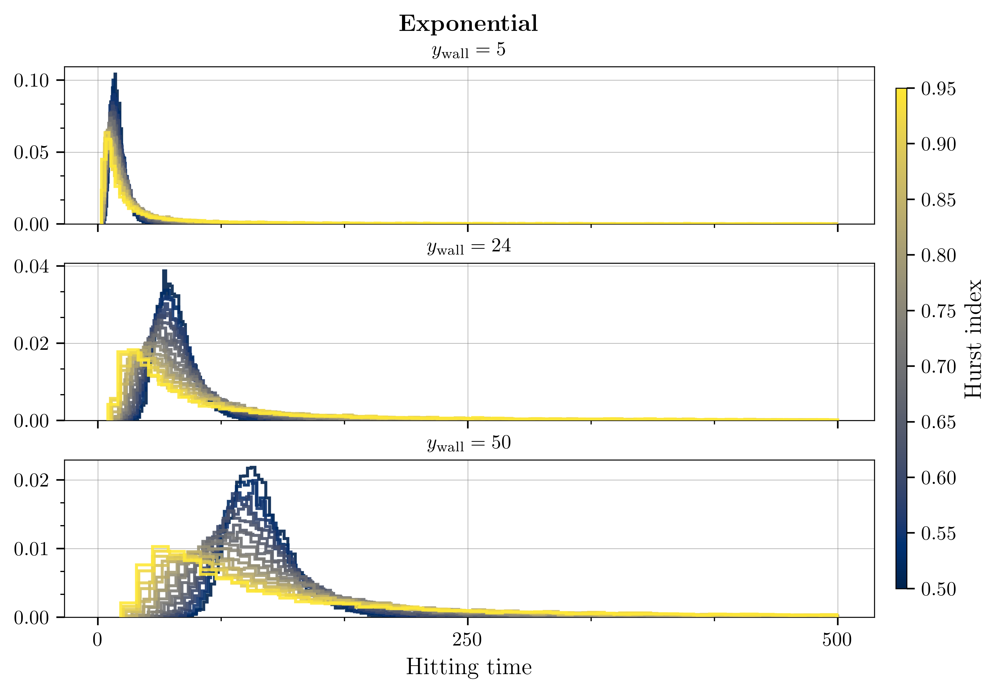

In [278]:

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Exponential6'],
     ['Exponential24'],
     ['Exponential50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=500,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    # width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

delta_plot = 1.5


folder = 'exponential_h_wall_delta'


list_files = os.listdir(folder)
        
dict6 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    
    if wall == 6:
        if h not in dict6:
            dict6[h] = None

        df = pd.read_csv(join(folder, archiv))

        dict6[h] = df

dict24 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 24:
        if h not in dict24:
            dict24[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict24[h] = df
    
dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta != delta_plot:
        continue
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df
        

h_values = sorted([x for x in list(dict6.keys()) if x != 0])

# h05

for h in h_values:
    df = dict6[h].dropna().to_numpy()

    ax['Exponential6'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                            zorder = 3, histtype='step', linewidth = 1.5)

for h in h_values:
    df = dict24[h].dropna().to_numpy()

    ax['Exponential24'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)



for h in h_values:
    df = dict50[h].dropna().to_numpy()

    ax['Exponential50'].hist(df, bins='auto', density=True, alpha=0.90, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                             zorder = 3, histtype='step', linewidth = 1.5)


# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Exponential6'].set_xticks([0,250, 500])
ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)


# Y-axis
y_limc5 = ax['Exponential6'].get_ylim()
y_limc24 = ax['Exponential24'].get_ylim()
y_limc50 = ax['Exponential50'].get_ylim()



# Titles
ax['Exponential6'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Exponential24'].set_title(r'$y_{\mathrm{wall}} = 24$', fontsize = 10)
ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels


ax['Exponential6'].annotate(
    r'\textbf{Exponential}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)
    
os.makedirs('figures/EmpiricalDistributions', exist_ok=True)
fig.savefig('figures/EmpiricalDistributions/ExponentialDistributionsDelta15.pdf', transparent=True, bbox_inches='tight')

# Comparison with BM

### With respect to Wall distance and delta = 1

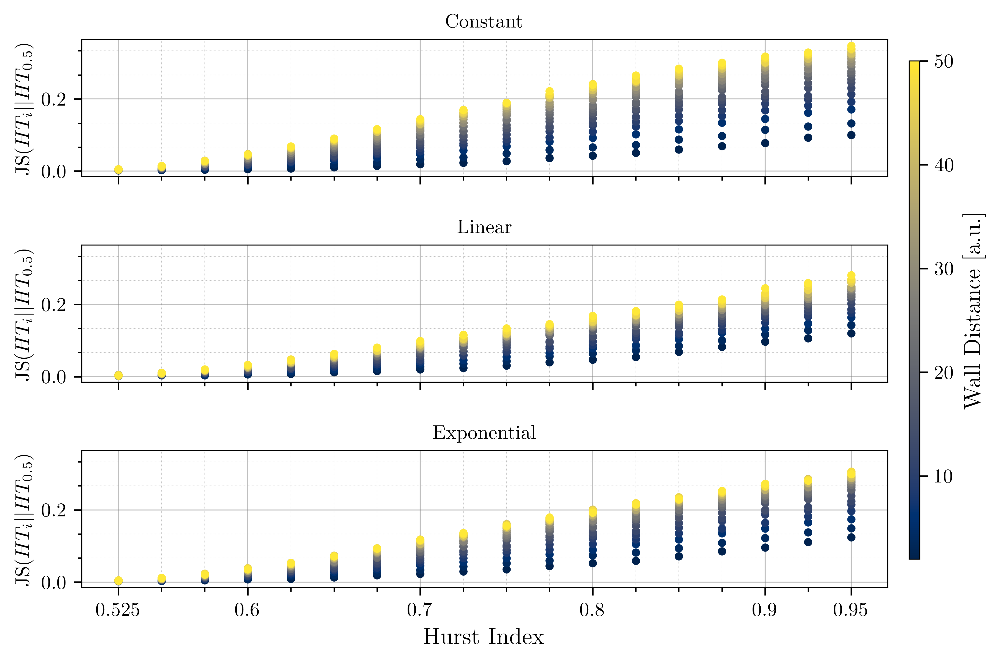

In [159]:
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    p = p[~np.isnan(p)]
    q = q[~np.isnan(q)]
    hist, bins_edge = np.histogram(p, bins='auto', density=True, )
    hist2, bins_edge = np.histogram(q, bins=bins_edge, density=True)
    
    
    return jensenshannon(hist, hist2)**2


fig, ax = plt.subplot_mosaic(
    [['JSConstant'],
     ['JSLinear'],
     ['JSExponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    sharey=True,
    gridspec_kw={"hspace": 0.5},
)

delta_value = 1

# constant
folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall


wall_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if delta == delta_value:
        if h not in dict_values.keys():
            dict_values[h] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[h][wall] = df.to_numpy()
        if wall not in wall_values:
            wall_values.append(wall)
        
    

norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis


for h in dict_values.keys():
    if h > 0.5:
        for wall, df in dict_values[h].items():
            val_05 = dict_values[0.5][wall]
            js_div = js_divergence(df, val_05)
            ax['JSConstant'].scatter(h, js_div,
                                     color = cmap(norm(wall)),
                                     s = 10, alpha = 1,
                                     zorder = 3 + wall
                                    )
            
# linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if delta == delta_value:
        if h not in dict_values.keys():
            dict_values[h] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[h][wall] = df.to_numpy()
        if wall not in wall_values:
            wall_values.append(wall)
        


for h in dict_values.keys():
    if h > 0.5:
        for wall, df in dict_values[h].items():
            val_05 = dict_values[0.5][wall]
            js_div = js_divergence(df, val_05)
            ax['JSLinear'].scatter(h, js_div,
                                     color = cmap(norm(wall)),
                                     s = 10, alpha = 1,
                                     zorder = 3 + wall
                                    )
        
# exponential
folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall


wall_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if delta == delta_value:
        if h not in dict_values.keys():
            dict_values[h] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[h][wall] = df.to_numpy()
        if wall not in wall_values:
            wall_values.append(wall)
        
    

norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis

h_plot = []
i = 0
for h in dict_values.keys():
    if h > 0.5:
        for wall, df in dict_values[h].items():
            val_05 = dict_values[0.5][wall]
            js_div = js_divergence(df, val_05)
            ax['JSExponential'].scatter(h, js_div,
                                     color = cmap(norm(wall)),
                                     s = 10, alpha = 1,
                                     zorder = 3 + wall
                                    )
            


# X-axis 
h_plot = [0.525, 0.6, 0.7, 0.8, 0.9, 0.95]
ax['JSExponential'].set_xlabel('Hurst Index', fontsize = 12)
ax['JSExponential'].set_xticks(h_plot)
ax['JSExponential'].set_xticklabels(['0.525', '0.6', '0.7', '0.8', '0.9', '0.95'])

# Y-axis
ax['JSConstant'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)
ax['JSLinear'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)
ax['JSExponential'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)

# titles
ax['JSConstant'].set_title(r'Constant', fontsize = 10)
ax['JSLinear'].set_title(r'Linear', fontsize = 10)
ax['JSExponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Wall Distance [a.u.]")

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.5, zorder = 0, alpha = 0.5)
    a.grid(which='minor', color='gray', linestyle=':', linewidth=0.25, zorder = 0, alpha = 0.5)
    

os.makedirs('figures/ComparisonBM', exist_ok=True)
fig.savefig('figures/ComparisonBM/JSBM_x_husrt_color_wall.pdf', transparent=True, bbox_inches='tight')

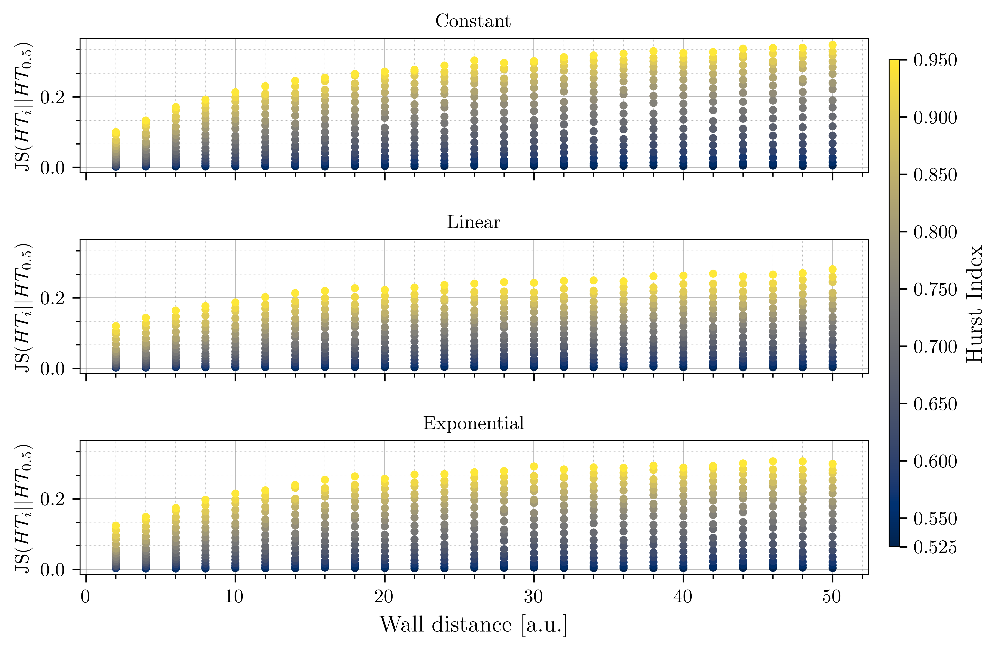

In [170]:
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    p = p[~np.isnan(p)]
    q = q[~np.isnan(q)]
    hist, bins_edge = np.histogram(p, bins='auto', density=True, )
    hist2, bins_edge = np.histogram(q, bins=bins_edge, density=True)
    
    
    return jensenshannon(hist, hist2)**2


fig, ax = plt.subplot_mosaic(
    [['JSConstant'],
     ['JSLinear'],
     ['JSExponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    sharey=True,
    gridspec_kw={"hspace": 0.5},
)

delta_value = 1

# constant
folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the wall values are dictionaries with keys as h


h_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if delta == delta_value:
        if wall not in dict_values.keys():
            dict_values[wall] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[wall][h] = df.to_numpy()
        if h not in h_values and h > 0.5:
            h_values.append(h)
        
    

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for wall in dict_values.keys():

    for h, df in dict_values[wall].items():
        if h > 0.5:
                
            val_05 = dict_values[wall][0.5]
            js_div = js_divergence(df, val_05)
            ax['JSConstant'].scatter(wall, js_div,
                                        color = cmap(norm(h)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + h
                                    )
                
                
                
                
                
                
                
                
# linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if delta == delta_value:
        if wall not in dict_values.keys():
            dict_values[wall] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[wall][h] = df.to_numpy()
        if h not in h_values and h > 0.5:
            h_values.append(h)
        
    

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for wall in dict_values.keys():

    for h, df in dict_values[wall].items():
        if h > 0.5:
                
            val_05 = dict_values[wall][0.5]
            js_div = js_divergence(df, val_05)
            ax['JSLinear'].scatter(wall, js_div,
                                        color = cmap(norm(h)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + h
                                    )
                
        
# exponential
folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall


wall_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if delta == delta_value:
        if wall not in dict_values.keys():
            dict_values[wall] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[wall][h] = df.to_numpy()
        if h not in h_values and h > 0.5:
            h_values.append(h)
        
    

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for wall in dict_values.keys():

    for h, df in dict_values[wall].items():
        if h > 0.5:
                
            val_05 = dict_values[wall][0.5]
            js_div = js_divergence(df, val_05)
            ax['JSExponential'].scatter(wall, js_div,
                                        color = cmap(norm(h)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + h
                                    )
                
            


# X-axis 

ax['JSExponential'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# Y-axis
ax['JSConstant'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)
ax['JSLinear'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)
ax['JSExponential'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)

# titles
ax['JSConstant'].set_title(r'Constant', fontsize = 10)
ax['JSLinear'].set_title(r'Linear', fontsize = 10)
ax['JSExponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst Index")
tick_cbar = [0.525, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]
cbar.set_ticks(tick_cbar)

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(5))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.5, zorder = 0, alpha = 0.5)
    a.grid(which='minor', color='gray', linestyle=':', linewidth=0.25, zorder = 0, alpha = 0.5)
    
os.makedirs('figures/ComparisonBM', exist_ok=True)
fig.savefig('figures/ComparisonBM/JSBM_x_wall_color_hurst.pdf', transparent=True, bbox_inches='tight')


### With respecto to Delta and Wall = 50

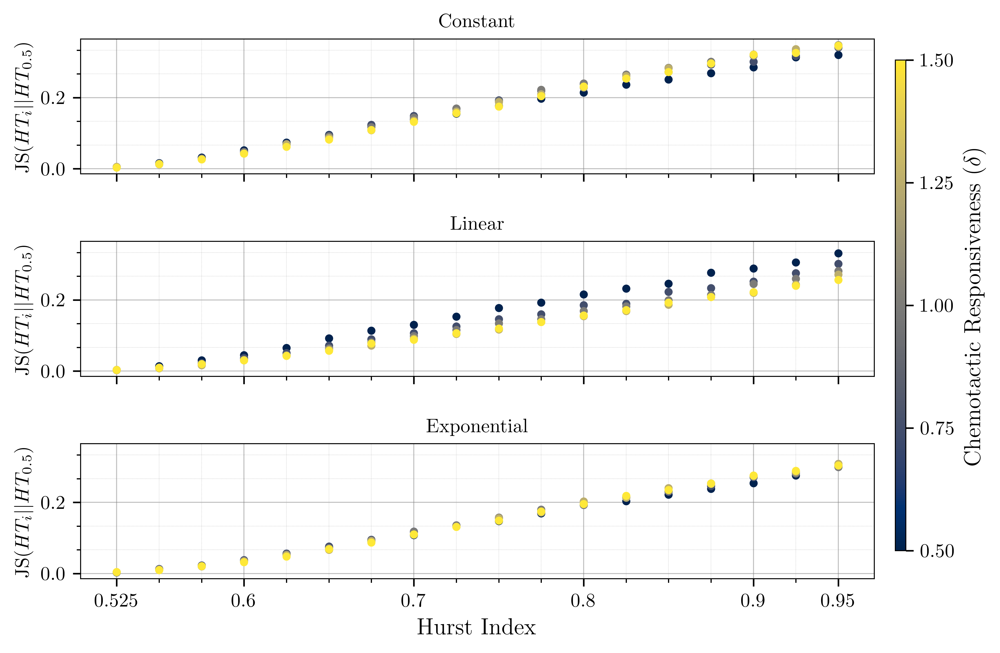

In [161]:
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    p = p[~np.isnan(p)]
    q = q[~np.isnan(q)]
    hist, bins_edge = np.histogram(p, bins='auto', density=True, )
    hist2, bins_edge = np.histogram(q, bins=bins_edge, density=True)
    
    
    return jensenshannon(hist, hist2)**2


fig, ax = plt.subplot_mosaic(
    [['JSConstant'],
     ['JSLinear'],
     ['JSExponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    sharey=True,
    gridspec_kw={"hspace": 0.5},
)

wall_value = 50

# constant
folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall


delta_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if wall == wall_value:
        if h not in dict_values.keys():
            dict_values[h] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[h][delta] = df.to_numpy()
        if delta not in delta_values:
            delta_values.append(delta)
        
    

norm = mcolors.Normalize(vmin=min(delta_values), vmax= max(delta_values))
cmap = plt.cm.cividis


for h in dict_values.keys():

    if h > 0.5:
        for delta, df in dict_values[h].items():
                
            val_05 = dict_values[0.5][delta]
            js_div = js_divergence(df, val_05)
            ax['JSConstant'].scatter(h, js_div,
                                        color = cmap(norm(delta)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + delta
                                    )
                    
                
                
                
                
                
                
                
# linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if wall == wall_value:
        if h not in dict_values.keys():
            dict_values[h] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[h][delta] = df.to_numpy()
        if delta not in delta_values:
            delta_values.append(delta)
        
    

norm = mcolors.Normalize(vmin=min(delta_values), vmax= max(delta_values))
cmap = plt.cm.cividis


for h in dict_values.keys():

    if h > 0.5:
        for delta, df in dict_values[h].items():
                
            val_05 = dict_values[0.5][delta]
            js_div = js_divergence(df, val_05)
            ax['JSLinear'].scatter(h, js_div,
                                        color = cmap(norm(delta)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + delta
                                    )
                
        
# exponential
folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall



for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if wall == wall_value:
        if h not in dict_values.keys():
            dict_values[h] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[h][delta] = df.to_numpy()
        if delta not in delta_values:
            delta_values.append(delta)
        
    

norm = mcolors.Normalize(vmin=min(delta_values), vmax= max(delta_values))
cmap = plt.cm.cividis


for h in dict_values.keys():

    if h > 0.5:
        for delta, df in dict_values[h].items():
                
            val_05 = dict_values[0.5][delta]
            js_div = js_divergence(df, val_05)
            ax['JSExponential'].scatter(h, js_div,
                                        color = cmap(norm(delta)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + delta
                                    )
                
            

# X-axis 
h_plot = [0.525, 0.6, 0.7, 0.8, 0.9, 0.95]
ax['JSExponential'].set_xlabel('Hurst Index', fontsize = 12)
ax['JSExponential'].set_xticks(h_plot)
ax['JSExponential'].set_xticklabels(['0.525', '0.6', '0.7', '0.8', '0.9', '0.95'])

# Y-axis
ax['JSConstant'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)
ax['JSLinear'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)
ax['JSExponential'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)

# titles
ax['JSConstant'].set_title(r'Constant', fontsize = 10)
ax['JSLinear'].set_title(r'Linear', fontsize = 10)
ax['JSExponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_ticks(delta_values)
cbar.set_label(r"Chemotactic Responsiveness $(\delta)$", fontsize = 12)

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.5, zorder = 0, alpha = 0.5)
    a.grid(which='minor', color='gray', linestyle=':', linewidth=0.25, zorder = 0, alpha = 0.5)
    

os.makedirs('figures/ComparisonBM', exist_ok=True)
fig.savefig('figures/ComparisonBM/JSBM_x_husrt_color_delta.pdf', transparent=True, bbox_inches='tight')

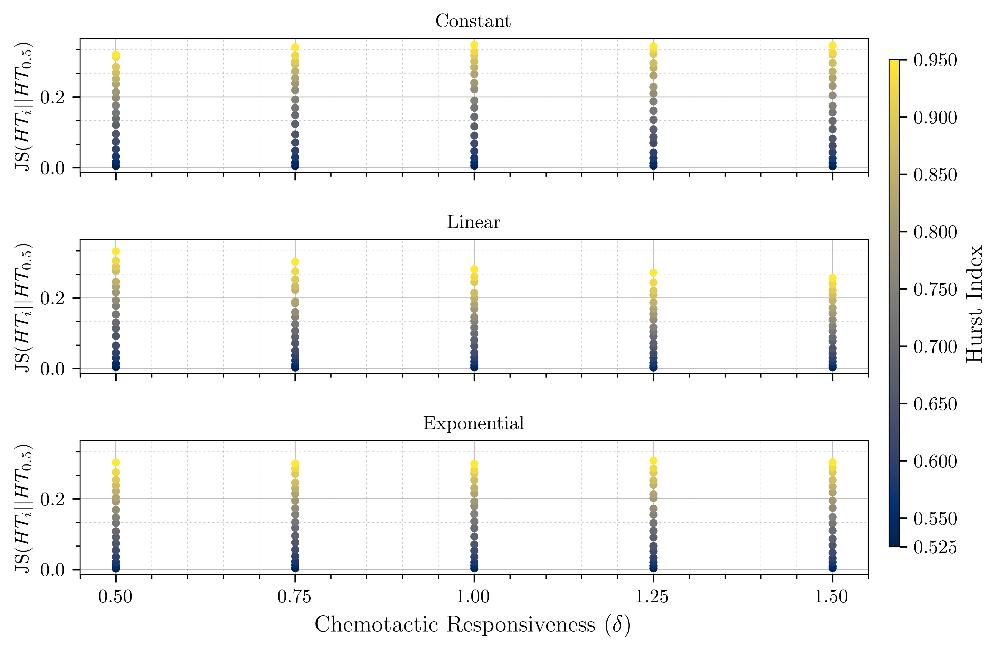

In [171]:
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    p = p[~np.isnan(p)]
    q = q[~np.isnan(q)]
    hist, bins_edge = np.histogram(p, bins='auto', density=True, )
    hist2, bins_edge = np.histogram(q, bins=bins_edge, density=True)
    
    
    return jensenshannon(hist, hist2)**2


fig, ax = plt.subplot_mosaic(
    [['JSConstant'],
     ['JSLinear'],
     ['JSExponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    sharey=True,
    gridspec_kw={"hspace": 0.5},
)

wall_values = 50

# constant
folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the wall values are dictionaries with keys as h


h_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if wall == wall_value:
        if delta not in dict_values.keys():
            dict_values[delta] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[delta][h] = df.to_numpy()
        if h not in h_values and h > 0.5:
            h_values.append(h)
        
    

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for delta in dict_values.keys():

    for h, df in dict_values[delta].items():
        if h > 0.5:
            val_05 = dict_values[delta][0.5]
            js_div = js_divergence(df, val_05)
            ax['JSConstant'].scatter(delta, js_div,
                                        color = cmap(norm(h)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + h
                                    )
                
                
                
                
                
                
                
                
# linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if wall == wall_value:
        if delta not in dict_values.keys():
            dict_values[delta] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[delta][h] = df.to_numpy()
        if h not in h_values and h > 0.5:
            h_values.append(h)
        
    

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for delta in dict_values.keys():

    for h, df in dict_values[delta].items():
        if h > 0.5:
            val_05 = dict_values[delta][0.5]
            js_div = js_divergence(df, val_05)
            ax['JSLinear'].scatter(delta, js_div,
                                        color = cmap(norm(h)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + h
                                    )
                
        
# exponential
folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values = {} # keys are the H values are dictionaries with keys as wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = round(float(archiv2[2].split('_')[1]),3)
    if wall == wall_value:
        if delta not in dict_values.keys():
            dict_values[delta] = {}

        df = pd.read_csv(join(folder, archiv))
        dict_values[delta][h] = df.to_numpy()
        if h not in h_values and h > 0.5:
            h_values.append(h)
        
    

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for delta in dict_values.keys():

    for h, df in dict_values[delta].items():
        if h > 0.5:
            val_05 = dict_values[delta][0.5]
            js_div = js_divergence(df, val_05)
            ax['JSExponential'].scatter(delta, js_div,
                                        color = cmap(norm(h)),
                                        s = 10, alpha = 1,
                                        zorder = 3 + h
                                    )
                
            


# X-axis 

ax['JSExponential'].set_xlabel(r"Chemotactic Responsiveness $(\delta)$")
ax['JSExponential'].set_xticks([0.5, 0.75, 1, 1.25, 1.5])

# Y-axis
ax['JSConstant'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)
ax['JSLinear'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)
ax['JSExponential'].set_ylabel(r'$\mathrm{JS}(HT_i||HT_{0.5})$', fontsize = 10)

# titles
ax['JSConstant'].set_title(r'Constant', fontsize = 10)
ax['JSLinear'].set_title(r'Linear', fontsize = 10)
ax['JSExponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst Index")
tick_cbar = [0.525, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]
cbar.set_ticks(tick_cbar)

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(5))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.5, zorder = 0, alpha = 0.5)
    a.grid(which='minor', color='gray', linestyle=':', linewidth=0.25, zorder = 0, alpha = 0.5)
    

os.makedirs('figures/ComparisonBM', exist_ok=True)
fig.savefig('figures/ComparisonBM/JSBM_x_delta_color_hurst.pdf', transparent=True, bbox_inches='tight')

# Comparison with other gradients

## Wall change delta 1

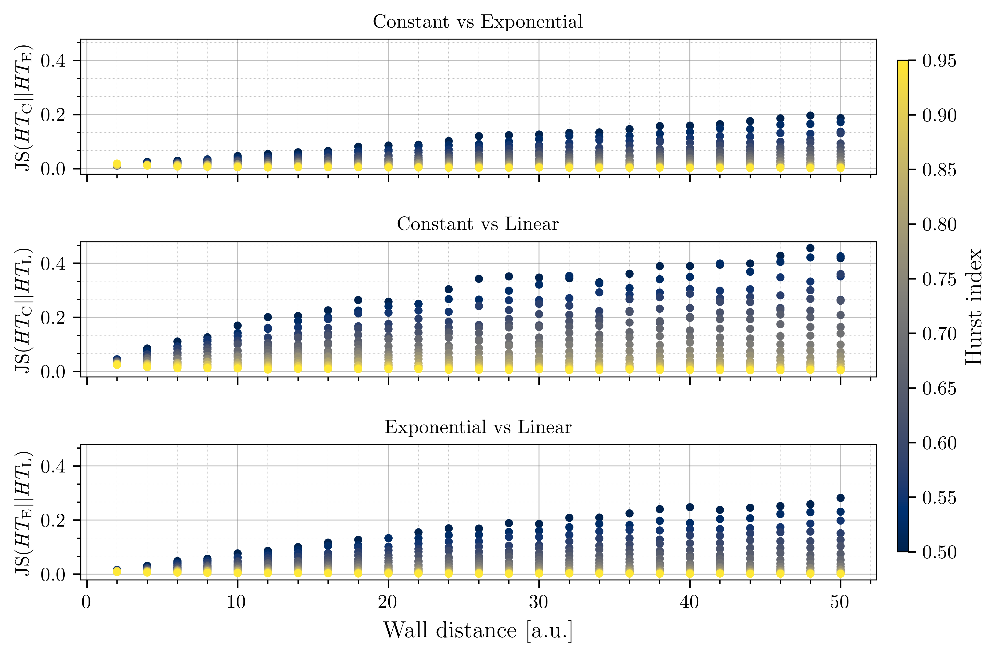

In [176]:
## distance between the different conditions
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})




def js_divergence(p, q):
    p = p[~np.isnan(p)]
    q = q[~np.isnan(q)]
    hist, bins_edge = np.histogram(p, bins='auto', density=True, )
    hist2, bins_edge = np.histogram(q, bins=bins_edge, density=True)
    
    
    return jensenshannon(hist, hist2)**2

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_constant = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_constant.keys():
        dict_wall_h_delta_constant[wall] = {}
    if h not in dict_wall_h_delta_constant[wall].keys():
        dict_wall_h_delta_constant[wall][h] = {}
    if delta not in dict_wall_h_delta_constant[wall][h].keys():
        dict_wall_h_delta_constant[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_constant[wall][h][delta] = df.to_numpy()
    
    
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_linear = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_linear.keys():
        dict_wall_h_delta_linear[wall] = {}
    if h not in dict_wall_h_delta_linear[wall].keys():
        dict_wall_h_delta_linear[wall][h] = {}
    if delta not in dict_wall_h_delta_linear[wall][h].keys():
        dict_wall_h_delta_linear[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_linear[wall][h][delta] = df.to_numpy()
    
    
folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_exponential = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_exponential.keys():
        dict_wall_h_delta_exponential[wall] = {}
    if h not in dict_wall_h_delta_exponential[wall].keys():
        dict_wall_h_delta_exponential[wall][h] = {}
    if delta not in dict_wall_h_delta_exponential[wall][h].keys():
        dict_wall_h_delta_exponential[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_exponential[wall][h][delta] = df.to_numpy()

fig, ax = plt.subplot_mosaic(
    [['ConstantVSExponential'],
     ['ConstantVSLinear'],
     ['ExponentialVSLinear']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    sharey=True,
    gridspec_kw={"hspace": 0.5},
)

#%% Constant vs Exponential

delta_value = 1
h_values = sorted([x for x in list(dict_wall_h_delta_constant[6].keys()) if x != 0])
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis
delta_value = 1
for wall in dict_wall_h_delta_constant.keys():
    for h in h_values:
        # constant
        df_1 = dict_wall_h_delta_constant[wall][h][delta_value]
        # exponential
        df_2 = dict_wall_h_delta_exponential[wall][h][delta_value]
        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ConstantVSExponential'].scatter(wall, js_div, 
                                 color = cmap(norm(h)),
                                 s = 10, alpha = 1,
                                 zorder = 3
                                )
        
#%% Constant vs Linear

for wall in dict_wall_h_delta_constant.keys():
    for h in h_values:
        # constant
        df_1 = dict_wall_h_delta_constant[wall][h][delta_value]
        # linear
        df_2 = dict_wall_h_delta_linear[wall][h][delta_value]

        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ConstantVSLinear'].scatter(wall, js_div, 
                                 color = cmap(norm(h)),
                                 s = 10, alpha = 1,
                                 zorder = 3
                                )
#%% Exponential vs Linear

for wall in dict_wall_h_delta_exponential.keys():
    for h in h_values:
        # exponential
        df_1 = dict_wall_h_delta_exponential[wall][h][delta_value]
        # linear
        df_2 = dict_wall_h_delta_linear[wall][h][delta_value]

        # calculate the JS divergence
        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ExponentialVSLinear'].scatter(wall, js_div, 
                                 color = cmap(norm(h)),
                                 s = 10, alpha = 1,
                                 zorder = 3
                                )
# cbar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['ExponentialVSLinear'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# titles
ax['ConstantVSExponential'].set_title(r'Constant vs Exponential', fontsize = 10)
ax['ConstantVSLinear'].set_title(r'Constant vs Linear', fontsize = 10)
ax['ExponentialVSLinear'].set_title(r'Exponential vs Linear', fontsize = 10)

# y-axis
ax['ConstantVSExponential'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{C}}||HT_{\mathrm{E}})$', fontsize = 10)
ax['ConstantVSLinear'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{C}}||HT_{\mathrm{L}})$', fontsize = 10)
ax['ExponentialVSLinear'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{E}}||HT_{\mathrm{L}})$', fontsize = 10)
# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(5))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.5, zorder = 0, alpha = 0.5)
    a.grid(which='minor', color='gray', linestyle=':', linewidth=0.25, zorder = 0, alpha = 0.5)
    
os.makedirs('figures/ComparisonOtherGradients', exist_ok=True)
fig.savefig('figures/ComparisonOtherGradients/JSGrad_x_wall_color_hurst.pdf', transparent=True, bbox_inches='tight')

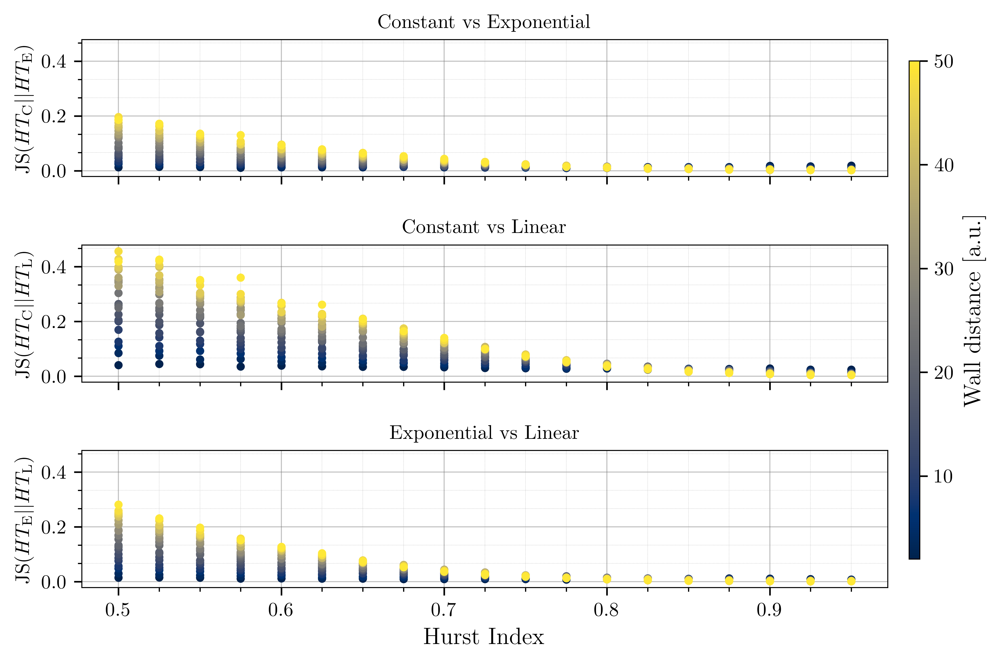

In [177]:
## distance between the different conditions
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})




def js_divergence(p, q):
    p = p[~np.isnan(p)]
    q = q[~np.isnan(q)]
    hist, bins_edge = np.histogram(p, bins='auto', density=True, )
    hist2, bins_edge = np.histogram(q, bins=bins_edge, density=True)
    
    
    return jensenshannon(hist, hist2)**2

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_constant = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_constant.keys():
        dict_wall_h_delta_constant[wall] = {}
    if h not in dict_wall_h_delta_constant[wall].keys():
        dict_wall_h_delta_constant[wall][h] = {}
    if delta not in dict_wall_h_delta_constant[wall][h].keys():
        dict_wall_h_delta_constant[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_constant[wall][h][delta] = df.to_numpy()
    
    
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_linear = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_linear.keys():
        dict_wall_h_delta_linear[wall] = {}
    if h not in dict_wall_h_delta_linear[wall].keys():
        dict_wall_h_delta_linear[wall][h] = {}
    if delta not in dict_wall_h_delta_linear[wall][h].keys():
        dict_wall_h_delta_linear[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_linear[wall][h][delta] = df.to_numpy()
    
    
folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_exponential = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_exponential.keys():
        dict_wall_h_delta_exponential[wall] = {}
    if h not in dict_wall_h_delta_exponential[wall].keys():
        dict_wall_h_delta_exponential[wall][h] = {}
    if delta not in dict_wall_h_delta_exponential[wall][h].keys():
        dict_wall_h_delta_exponential[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_exponential[wall][h][delta] = df.to_numpy()

fig, ax = plt.subplot_mosaic(
    [['ConstantVSExponential'],
     ['ConstantVSLinear'],
     ['ExponentialVSLinear']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    sharey=True,
    gridspec_kw={"hspace": 0.5},
)

#%% Constant vs Exponential

delta_value = 1

wall_values = sorted([x for x in list(dict_wall_h_delta_constant.keys()) ])
h_values = sorted([x for x in list(dict_wall_h_delta_constant[6].keys()) ])
delta_values = sorted([x for x in list(dict_wall_h_delta_constant[6][h].keys()) ])

norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis
delta_value = 1
for h in h_values:
    for wall in wall_values:
        # constant
        df_1 = dict_wall_h_delta_constant[wall][h][delta_value]
        # exponential
        df_2 = dict_wall_h_delta_exponential[wall][h][delta_value]
        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ConstantVSExponential'].scatter(h, js_div, 
                                 color = cmap(norm(wall)),
                                 s = 10, alpha = 1,
                                 zorder = 3 + wall
                                )
        
#%% Constant vs Linear

for h in h_values:
    for wall in wall_values:
        # constant
        df_1 = dict_wall_h_delta_constant[wall][h][delta_value]
        # linear
        df_2 = dict_wall_h_delta_linear[wall][h][delta_value]

        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ConstantVSLinear'].scatter(h, js_div, 
                                 color = cmap(norm(wall)),
                                 s = 10, alpha = 1,
                                 zorder = 3
                                )
#%% Exponential vs Linear

for h in h_values:
    for wall in wall_values:
        # exponential
        df_1 = dict_wall_h_delta_exponential[wall][h][delta_value]
        # linear
        df_2 = dict_wall_h_delta_linear[wall][h][delta_value]

        # calculate the JS divergence
        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ExponentialVSLinear'].scatter(h, js_div, 
                                 color = cmap(norm(wall)),
                                 s = 10, alpha = 1,
                                 zorder = 3
                                )
# cbar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Wall distance [a.u.]")

# X-axis
ax['ExponentialVSLinear'].set_xlabel('Hurst Index', fontsize = 12)
# titles
ax['ConstantVSExponential'].set_title(r'Constant vs Exponential', fontsize = 10)
ax['ConstantVSLinear'].set_title(r'Constant vs Linear', fontsize = 10)
ax['ExponentialVSLinear'].set_title(r'Exponential vs Linear', fontsize = 10)

# y-axis
ax['ConstantVSExponential'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{C}}||HT_{\mathrm{E}})$', fontsize = 10)
ax['ConstantVSLinear'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{C}}||HT_{\mathrm{L}})$', fontsize = 10)
ax['ExponentialVSLinear'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{E}}||HT_{\mathrm{L}})$', fontsize = 10)
# ticks
# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.5, zorder = 0, alpha = 0.5)
    a.grid(which='minor', color='gray', linestyle=':', linewidth=0.25, zorder = 0, alpha = 0.5)
    
os.makedirs('figures/ComparisonOtherGradients', exist_ok=True)
fig.savefig('figures/ComparisonOtherGradients/JSGrad_x_hurst_color_wall.pdf', transparent=True, bbox_inches='tight')

## Delta change wall 50

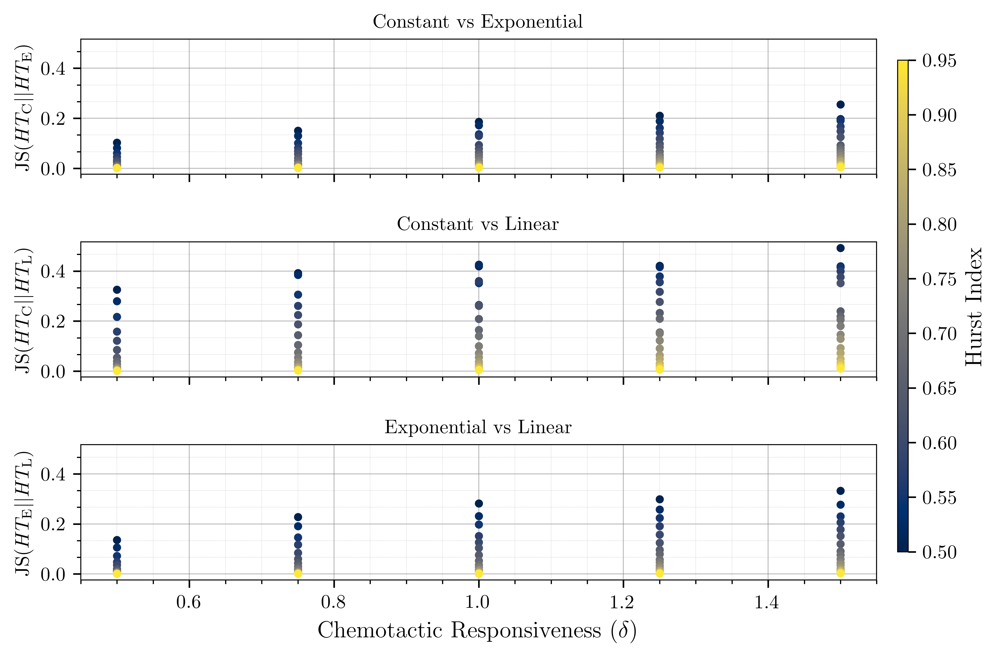

In [178]:
## distance between the different conditions
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})




def js_divergence(p, q):
    p = p[~np.isnan(p)]
    q = q[~np.isnan(q)]
    hist, bins_edge = np.histogram(p, bins='auto', density=True, )
    hist2, bins_edge = np.histogram(q, bins=bins_edge, density=True)
    
    
    return jensenshannon(hist, hist2)**2

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_constant = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_constant.keys():
        dict_wall_h_delta_constant[wall] = {}
    if h not in dict_wall_h_delta_constant[wall].keys():
        dict_wall_h_delta_constant[wall][h] = {}
    if delta not in dict_wall_h_delta_constant[wall][h].keys():
        dict_wall_h_delta_constant[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_constant[wall][h][delta] = df.to_numpy()
    
    
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_linear = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_linear.keys():
        dict_wall_h_delta_linear[wall] = {}
    if h not in dict_wall_h_delta_linear[wall].keys():
        dict_wall_h_delta_linear[wall][h] = {}
    if delta not in dict_wall_h_delta_linear[wall][h].keys():
        dict_wall_h_delta_linear[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_linear[wall][h][delta] = df.to_numpy()
    
    
folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_exponential = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_exponential.keys():
        dict_wall_h_delta_exponential[wall] = {}
    if h not in dict_wall_h_delta_exponential[wall].keys():
        dict_wall_h_delta_exponential[wall][h] = {}
    if delta not in dict_wall_h_delta_exponential[wall][h].keys():
        dict_wall_h_delta_exponential[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_exponential[wall][h][delta] = df.to_numpy()

fig, ax = plt.subplot_mosaic(
    [['ConstantVSExponential'],
     ['ConstantVSLinear'],
     ['ExponentialVSLinear']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    sharey=True,
    gridspec_kw={"hspace": 0.5},
)

#%% Constant vs Exponential

wall_value = 50

wall_values = sorted([x for x in list(dict_wall_h_delta_constant.keys()) ])
h_values = sorted([x for x in list(dict_wall_h_delta_constant[6].keys()) ])
delta_values = sorted([x for x in list(dict_wall_h_delta_constant[6][h].keys()) ])

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis
delta_value = 1
for delta in delta_values:
    for h in h_values:
        # constant
        df_1 = dict_wall_h_delta_constant[wall_value][h][delta]
        # exponential
        df_2 = dict_wall_h_delta_exponential[wall_value][h][delta]
        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ConstantVSExponential'].scatter(delta, js_div, 
                                 color = cmap(norm(h)),
                                 s = 10, alpha = 1,
                                 zorder = 3 + h
                                )
        
#%% Constant vs Linear

for delta in delta_values:
    for h in h_values:
        # constant
        df_1 = dict_wall_h_delta_constant[wall_value][h][delta]
        # linear
        df_2 = dict_wall_h_delta_linear[wall_value][h][delta]

        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ConstantVSLinear'].scatter(delta, js_div, 
                                 color = cmap(norm(h)),
                                 s = 10, alpha = 1,
                                 zorder = 3 + h
                                )
#%% Exponential vs Linear

for delta in delta_values:
    for h in h_values:
        # exponential
        df_1 = dict_wall_h_delta_exponential[wall_value][h][delta]
        # linear
        df_2 = dict_wall_h_delta_linear[wall_value][h][delta]

        # calculate the JS divergence
        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ExponentialVSLinear'].scatter(delta, js_div, 
                                 color = cmap(norm(h)),
                                 s = 10, alpha = 1,
                                 zorder = 3 + h
                                )
# cbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst Index")
# X-axis
ax['ExponentialVSLinear'].set_xlabel(r"Chemotactic Responsiveness $(\delta)$", fontsize = 12)
# titles
ax['ConstantVSExponential'].set_title(r'Constant vs Exponential', fontsize = 10)
ax['ConstantVSLinear'].set_title(r'Constant vs Linear', fontsize = 10)
ax['ExponentialVSLinear'].set_title(r'Exponential vs Linear', fontsize = 10)

# y-axis
ax['ConstantVSExponential'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{C}}||HT_{\mathrm{E}})$', fontsize = 10)
ax['ConstantVSLinear'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{C}}||HT_{\mathrm{L}})$', fontsize = 10)
ax['ExponentialVSLinear'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{E}}||HT_{\mathrm{L}})$', fontsize = 10)
# ticks
# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.5, zorder = 0, alpha = 0.5)
    a.grid(which='minor', color='gray', linestyle=':', linewidth=0.25, zorder = 0, alpha = 0.5)
    
os.makedirs('figures/ComparisonOtherGradients', exist_ok=True)
fig.savefig('figures/ComparisonOtherGradients/JSGrad_x_delta_color_hurst.pdf', transparent=True, bbox_inches='tight')

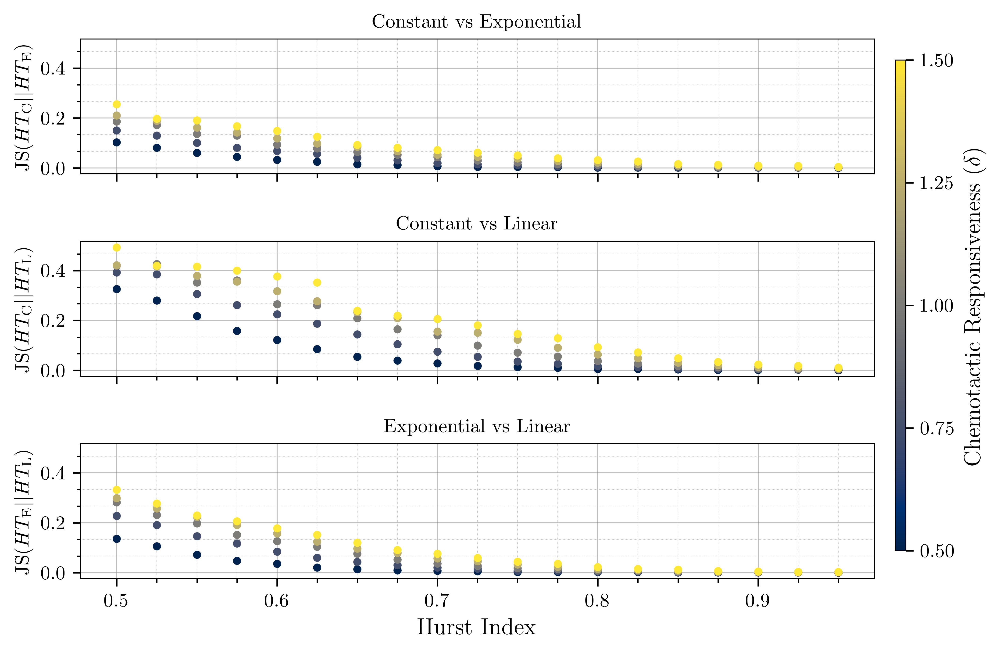

In [180]:
## distance between the different conditions
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})




def js_divergence(p, q):
    p = p[~np.isnan(p)]
    q = q[~np.isnan(q)]
    hist, bins_edge = np.histogram(p, bins='auto', density=True, )
    hist2, bins_edge = np.histogram(q, bins=bins_edge, density=True)
    
    
    return jensenshannon(hist, hist2)**2

folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_constant = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_constant.keys():
        dict_wall_h_delta_constant[wall] = {}
    if h not in dict_wall_h_delta_constant[wall].keys():
        dict_wall_h_delta_constant[wall][h] = {}
    if delta not in dict_wall_h_delta_constant[wall][h].keys():
        dict_wall_h_delta_constant[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_constant[wall][h][delta] = df.to_numpy()
    
    
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_linear = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_linear.keys():
        dict_wall_h_delta_linear[wall] = {}
    if h not in dict_wall_h_delta_linear[wall].keys():
        dict_wall_h_delta_linear[wall][h] = {}
    if delta not in dict_wall_h_delta_linear[wall][h].keys():
        dict_wall_h_delta_linear[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_linear[wall][h][delta] = df.to_numpy()
    
    
folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_wall_h_delta_exponential = {} # wall keys, h values, delta values

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if wall not in dict_wall_h_delta_exponential.keys():
        dict_wall_h_delta_exponential[wall] = {}
    if h not in dict_wall_h_delta_exponential[wall].keys():
        dict_wall_h_delta_exponential[wall][h] = {}
    if delta not in dict_wall_h_delta_exponential[wall][h].keys():
        dict_wall_h_delta_exponential[wall][h][delta] = None
    df = pd.read_csv(join(folder, archiv))
    dict_wall_h_delta_exponential[wall][h][delta] = df.to_numpy()

fig, ax = plt.subplot_mosaic(
    [['ConstantVSExponential'],
     ['ConstantVSLinear'],
     ['ExponentialVSLinear']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    sharey=True,
    gridspec_kw={"hspace": 0.5},
)

#%% Constant vs Exponential

wall_value = 50

wall_values = sorted([x for x in list(dict_wall_h_delta_constant.keys()) ])
h_values = sorted([x for x in list(dict_wall_h_delta_constant[6].keys()) ])
delta_values = sorted([x for x in list(dict_wall_h_delta_constant[6][h].keys()) ])

norm = mcolors.Normalize(vmin=min(delta_values), vmax= max(delta_values))
cmap = plt.cm.cividis
delta_value = 1
for h in h_values:
    for delta in delta_values:
        # constant
        df_1 = dict_wall_h_delta_constant[wall_value][h][delta]
        # exponential
        df_2 = dict_wall_h_delta_exponential[wall_value][h][delta]
        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ConstantVSExponential'].scatter(h, js_div, 
                                 color = cmap(norm(delta)),
                                 s = 10, alpha = 1,
                                 zorder = 3 + delta
                                )
        
#%% Constant vs Linear

for h in h_values:
    for delta in delta_values:
        # constant
        df_1 = dict_wall_h_delta_constant[wall_value][h][delta]
        # linear
        df_2 = dict_wall_h_delta_linear[wall_value][h][delta]

        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ConstantVSLinear'].scatter(h, js_div, 
                                 color = cmap(norm(delta)),
                                 s = 10, alpha = 1,
                                 zorder = 3 + delta
                                )
#%% Exponential vs Linear

for h in h_values:
    for delta in delta_values:
        # exponential
        df_1 = dict_wall_h_delta_exponential[wall_value][h][delta]
        # linear
        df_2 = dict_wall_h_delta_linear[wall_value][h][delta]

        # calculate the JS divergence
        js_div = js_divergence(df_1, df_2)
        # plot the JS divergence
        ax['ExponentialVSLinear'].scatter(h, js_div, 
                                 color = cmap(norm(delta)),
                                 s = 10, alpha = 1,
                                 zorder = 3 + delta
                                )
# cbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_ticks(delta_values)
cbar.set_label(r"Chemotactic Responsiveness $(\delta)$", fontsize = 12)


# X-axis
ax['ExponentialVSLinear'].set_xlabel('Hurst Index', fontsize = 12)
# titles
ax['ConstantVSExponential'].set_title(r'Constant vs Exponential', fontsize = 10)
ax['ConstantVSLinear'].set_title(r'Constant vs Linear', fontsize = 10)
ax['ExponentialVSLinear'].set_title(r'Exponential vs Linear', fontsize = 10)

# y-axis
ax['ConstantVSExponential'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{C}}||HT_{\mathrm{E}})$', fontsize = 10)
ax['ConstantVSLinear'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{C}}||HT_{\mathrm{L}})$', fontsize = 10)
ax['ExponentialVSLinear'].set_ylabel(r'$\mathrm{JS}(HT_{\mathrm{E}}||HT_{\mathrm{L}})$', fontsize = 10)
# ticks
# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.5, zorder = 0, alpha = 0.5)
    a.grid(which='minor', color='gray', linestyle=':', linewidth=0.25, zorder = 0, alpha = 0.5)
    
os.makedirs('figures/ComparisonOtherGradients', exist_ok=True)
fig.savefig('figures/ComparisonOtherGradients/JSGrad_x_hurst_color_delta.pdf', transparent=True, bbox_inches='tight')

# Characterization Plots

## Median w.r.t. Hurst and Wall change

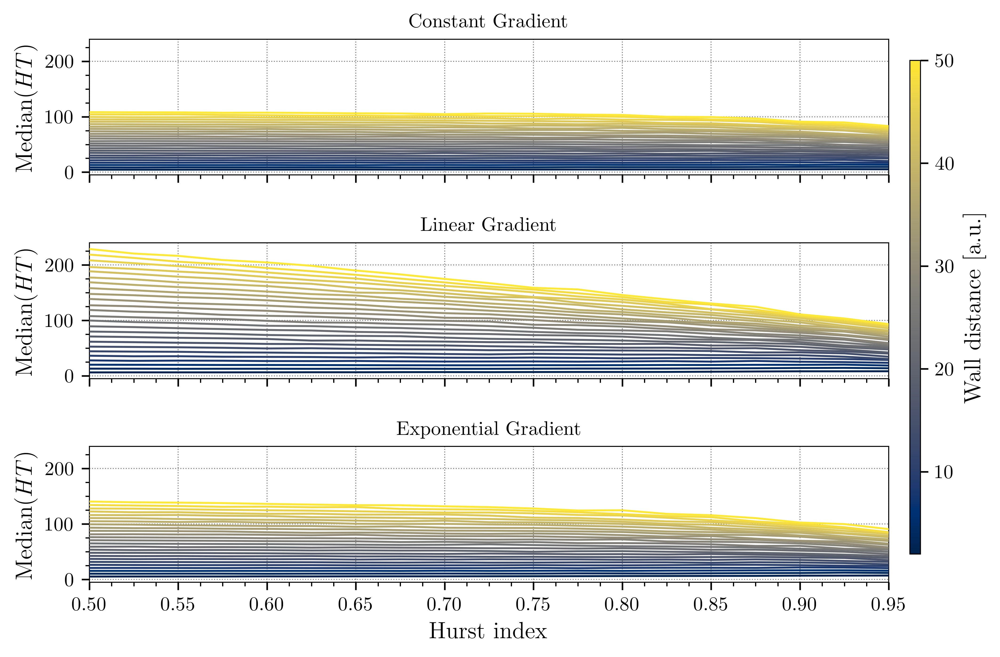

In [248]:
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)
delta_value = 1

folder = 'constant_h_wall_delta'

list_files = os.listdir(folder)
dict_values_plot = {}
wall_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if wall not in dict_values_plot.keys():
            dict_values_plot[wall] = []
        dict_values_plot[wall].append((h, moment))
        
wall_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
    
#----------- Linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if wall not in dict_values_plot.keys():
            dict_values_plot[wall] = []
        dict_values_plot[wall].append((h, moment))
        
wall_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
        
        
# ----------- Exponential

folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if wall not in dict_values_plot.keys():
            dict_values_plot[wall] = []
        dict_values_plot[wall].append((h, moment))
        
wall_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)


# --- X axis

ax['Constant'].set_xticks([0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95])
ax['Exponential'].set_xlabel('Hurst index', fontsize = 12)
ax['Constant'].set_xlim([0.5, 0.95])
# --- Y axis
c_ylim = ax['Constant'].get_ylim()
l_ylim = ax['Linear'].get_ylim()
e_ylim = ax['Exponential'].get_ylim()


ylims = [np.min([c_ylim[0], l_ylim[0], e_ylim[0]]), np.max([c_ylim[1], l_ylim[1], e_ylim[1]])]
ax['Constant'].set_ylim(ylims)
ax['Linear'].set_ylim(ylims)
ax['Exponential'].set_ylim(ylims)


ax['Constant'].set_ylabel(r'Median($HT$)')
ax['Linear'].set_ylabel(r'Median($HT$)')
ax['Exponential'].set_ylabel(r'Median($HT$)')
# titles
ax['Constant'].set_title(r'Constant Gradient', fontsize = 10)
ax['Linear'].set_title(r'Linear Gradient', fontsize = 10)
ax['Exponential'].set_title(r'Exponential Gradient', fontsize = 10)
# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    


fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
# cbar.set_ticks(wall_values)
cbar.set_label("Wall distance [a.u.]", fontsize = 12)

os.makedirs('figures/CharacterizationPlots', exist_ok=True)
fig.savefig('figures/CharacterizationPlots/Median_x_hurst_color_wall.pdf', transparent=True, bbox_inches='tight')

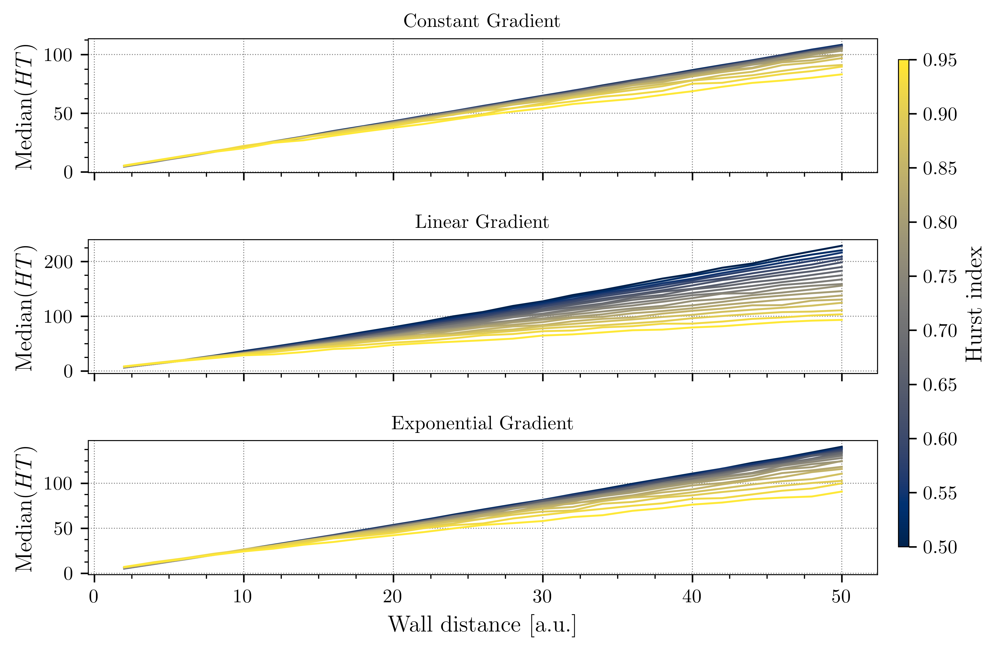

In [249]:
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)
delta_value = 1

folder = 'constant_h_wall_delta'

list_files = os.listdir(folder)
dict_values_plot = {}

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((wall, moment))
        
h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val = df_val.sort_values(by = 'Wall')
    df_val = df_val.reset_index(drop = True)
    df_val['Wall'] = df_val['Wall'].astype(float)
    df_val['Moment'] = df_val['Moment'].astype(float)
    ax['Constant'].plot( df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(float(key))), zorder = 3 + key)
    
    
    
#----------- Linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((wall, moment))
        
h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val = df_val.sort_values(by = 'Wall')
    df_val = df_val.reset_index(drop = True)
    df_val['Wall'] = df_val['Wall'].astype(float)
    df_val['Moment'] = df_val['Moment'].astype(float)
    ax['Linear'].plot( df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(float(key))), zorder = 3 + key)
    
    
        
# ----------- Exponential

folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((wall, moment))
        
h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val = df_val.sort_values(by = 'Wall')
    df_val = df_val.reset_index(drop = True)
    df_val['Wall'] = df_val['Wall'].astype(float)
    df_val['Moment'] = df_val['Moment'].astype(float)
    ax['Exponential'].plot( df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(float(key))), zorder = 3 + key)
    
    


# --- X axis

ax['Exponential'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# --- Y axis
# c_ylim = ax['Constant'].get_ylim()
# l_ylim = ax['Linear'].get_ylim()
# e_ylim = ax['Exponential'].get_ylim()


# ylims = [np.min([c_ylim[0], l_ylim[0], e_ylim[0]]), np.max([c_ylim[1], l_ylim[1], e_ylim[1]])]
# ax['Constant'].set_ylim(ylims)
# ax['Linear'].set_ylim(ylims)
# ax['Exponential'].set_ylim(ylims)


ax['Constant'].set_ylabel(r'Median($HT$)')
ax['Linear'].set_ylabel(r'Median($HT$)')
ax['Exponential'].set_ylabel(r'Median($HT$)')
# titles
ax['Constant'].set_title(r'Constant Gradient', fontsize = 10)
ax['Linear'].set_title(r'Linear Gradient', fontsize = 10)
ax['Exponential'].set_title(r'Exponential Gradient', fontsize = 10)

# Color map
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
# cbar.set_ticks(wall_values)
cbar.set_label("Hurst index", fontsize = 12)


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    


plt.show()
os.makedirs('figures/CharacterizationPlots', exist_ok=True)
fig.savefig('figures/CharacterizationPlots/Median_x_wall_color_hurst.pdf', transparent=True, bbox_inches='tight')

## Mode w.r.t. Hurst and Wall change

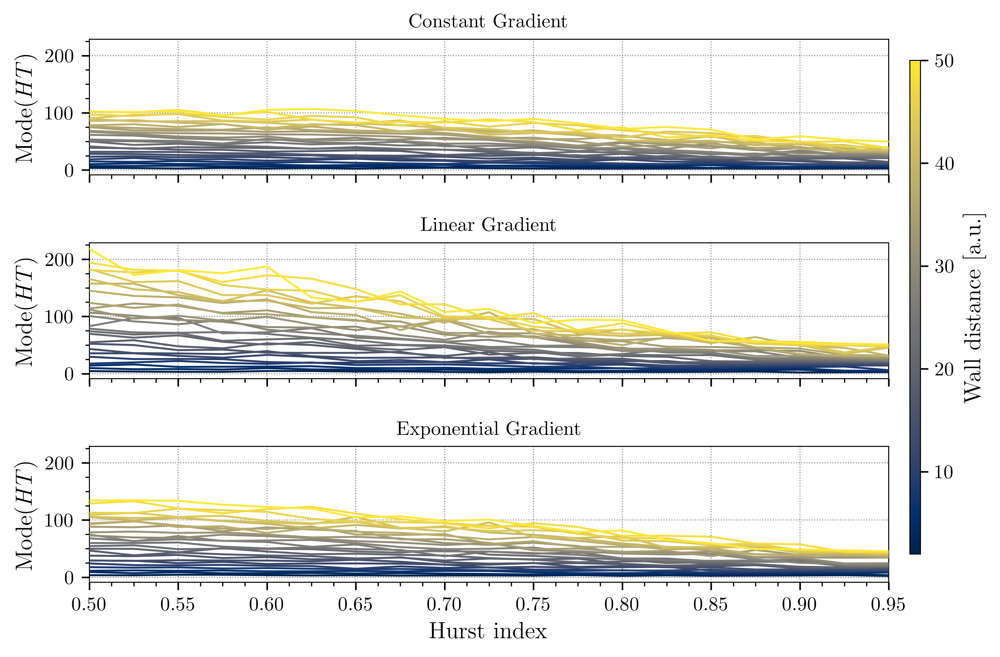

In [250]:
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def get_maximum(dist):
    hist_1, bin_edges_1 = np.histogram(dist, bins='auto', density=True)
    bin_centers_1 = 0.5 * (bin_edges_1[1:] + bin_edges_1[:-1])
    max_ind = np.argmax(hist_1)
    
    return bin_centers_1[max_ind], hist_1[max_ind]


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)
delta_value = 1

folder = 'constant_h_wall_delta'

list_files = os.listdir(folder)
dict_values_plot = {}
wall_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if wall not in dict_values_plot.keys():
            dict_values_plot[wall] = []
        dict_values_plot[wall].append((h, moment))
        
wall_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
    
#----------- Linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if wall not in dict_values_plot.keys():
            dict_values_plot[wall] = []
        dict_values_plot[wall].append((h, moment))
        
wall_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
        
        
# ----------- Exponential

folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if wall not in dict_values_plot.keys():
            dict_values_plot[wall] = []
        dict_values_plot[wall].append((h, moment))
        
wall_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)


# --- X axis

ax['Constant'].set_xticks([0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95])
ax['Exponential'].set_xlabel('Hurst index', fontsize = 12)
ax['Constant'].set_xlim([0.5, 0.95])
# --- Y axis
c_ylim = ax['Constant'].get_ylim()
l_ylim = ax['Linear'].get_ylim()
e_ylim = ax['Exponential'].get_ylim()


# ax['Constant'].set_yscale('log')
# ax['Linear'].set_yscale('log')
# ax['Exponential'].set_yscale('log')

ylims = [np.min([c_ylim[0], l_ylim[0], e_ylim[0]]), np.max([c_ylim[1], l_ylim[1], e_ylim[1]])]
ax['Constant'].set_ylim(ylims)
ax['Linear'].set_ylim(ylims)
ax['Exponential'].set_ylim(ylims)

ax['Constant'].set_ylabel(r'Mode($HT$)', fontsize = 12)
ax['Linear'].set_ylabel(r'Mode($HT$)', fontsize = 12)
ax['Exponential'].set_ylabel(r'Mode($HT$)', fontsize = 12)
# titles
ax['Constant'].set_title(r'Constant Gradient', fontsize = 10)
ax['Linear'].set_title(r'Linear Gradient', fontsize = 10)
ax['Exponential'].set_title(r'Exponential Gradient', fontsize = 10)
# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    


fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
# cbar.set_ticks(wall_values)
cbar.set_label("Wall distance [a.u.]", fontsize = 12)

os.makedirs('figures/CharacterizationPlots', exist_ok=True)
fig.savefig('figures/CharacterizationPlots/Mode_x_hurst_color_wall.pdf', transparent=True, bbox_inches='tight')

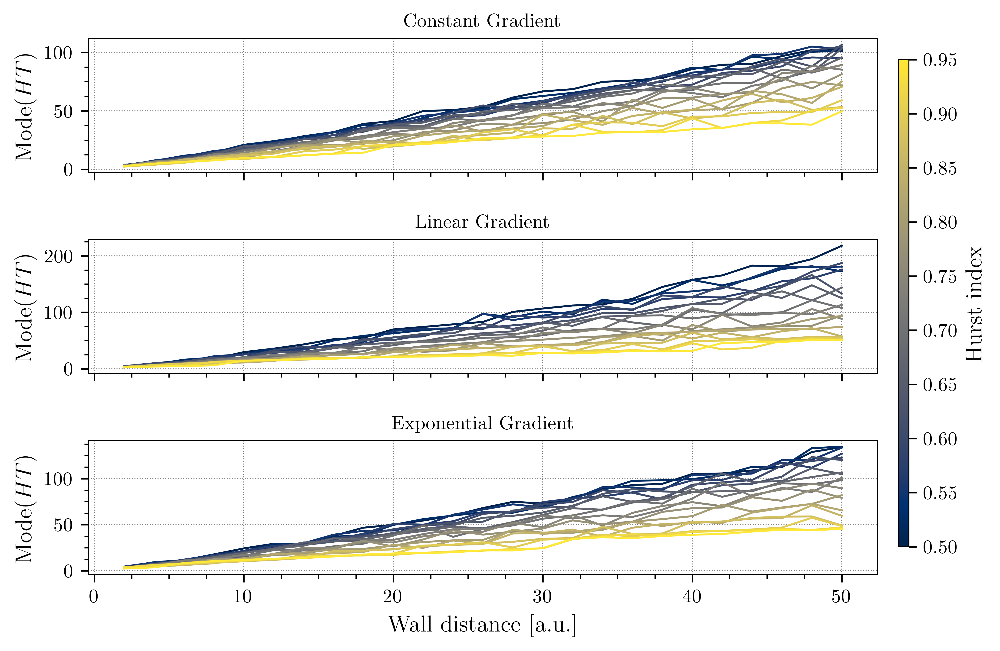

In [251]:
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

def get_maximum(dist):
    hist_1, bin_edges_1 = np.histogram(dist, bins='auto', density=True)
    bin_centers_1 = 0.5 * (bin_edges_1[1:] + bin_edges_1[:-1])
    max_ind = np.argmax(hist_1)
    
    return bin_centers_1[max_ind], hist_1[max_ind]

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)
delta_value = 1

folder = 'constant_h_wall_delta'

list_files = os.listdir(folder)
dict_values_plot = {}

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((wall, moment))
        
h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val = df_val.sort_values(by = 'Wall')
    df_val = df_val.reset_index(drop = True)
    df_val['Wall'] = df_val['Wall'].astype(float)
    df_val['Moment'] = df_val['Moment'].astype(float)
    ax['Constant'].plot( df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(float(key))), zorder = 3 + key)
    
    
    
#----------- Linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((wall, moment))
        
h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val = df_val.sort_values(by = 'Wall')
    df_val = df_val.reset_index(drop = True)
    df_val['Wall'] = df_val['Wall'].astype(float)
    df_val['Moment'] = df_val['Moment'].astype(float)
    ax['Linear'].plot( df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(float(key))), zorder = 3 + key)
    
    
        
# ----------- Exponential

folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if delta == delta_value:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((wall, moment))
        
h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val = df_val.sort_values(by = 'Wall')
    df_val = df_val.reset_index(drop = True)
    df_val['Wall'] = df_val['Wall'].astype(float)
    df_val['Moment'] = df_val['Moment'].astype(float)
    ax['Exponential'].plot( df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(float(key))), zorder = 3 + key)
    
    


# --- X axis

ax['Exponential'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# --- Y axis
# c_ylim = ax['Constant'].get_ylim()
# l_ylim = ax['Linear'].get_ylim()
# e_ylim = ax['Exponential'].get_ylim()


# ylims = [np.min([c_ylim[0], l_ylim[0], e_ylim[0]]), np.max([c_ylim[1], l_ylim[1], e_ylim[1]])]
# ax['Constant'].set_ylim(ylims)
# ax['Linear'].set_ylim(ylims)
# ax['Exponential'].set_ylim(ylims)


ax['Constant'].set_ylabel(r'Mode($HT$)')
ax['Linear'].set_ylabel(r'Mode($HT$)')
ax['Exponential'].set_ylabel(r'Mode($HT$)')
# titles
ax['Constant'].set_title(r'Constant Gradient', fontsize = 10)
ax['Linear'].set_title(r'Linear Gradient', fontsize = 10)
ax['Exponential'].set_title(r'Exponential Gradient', fontsize = 10)

# Color map
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
# cbar.set_ticks(wall_values)
cbar.set_label("Hurst index", fontsize = 12)


for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    


plt.show()
os.makedirs('figures/CharacterizationPlots', exist_ok=True)
fig.savefig('figures/CharacterizationPlots/Mode_x_wall_color_hurst.pdf', transparent=True, bbox_inches='tight')

## Median w.r.t. Hurst at delta change

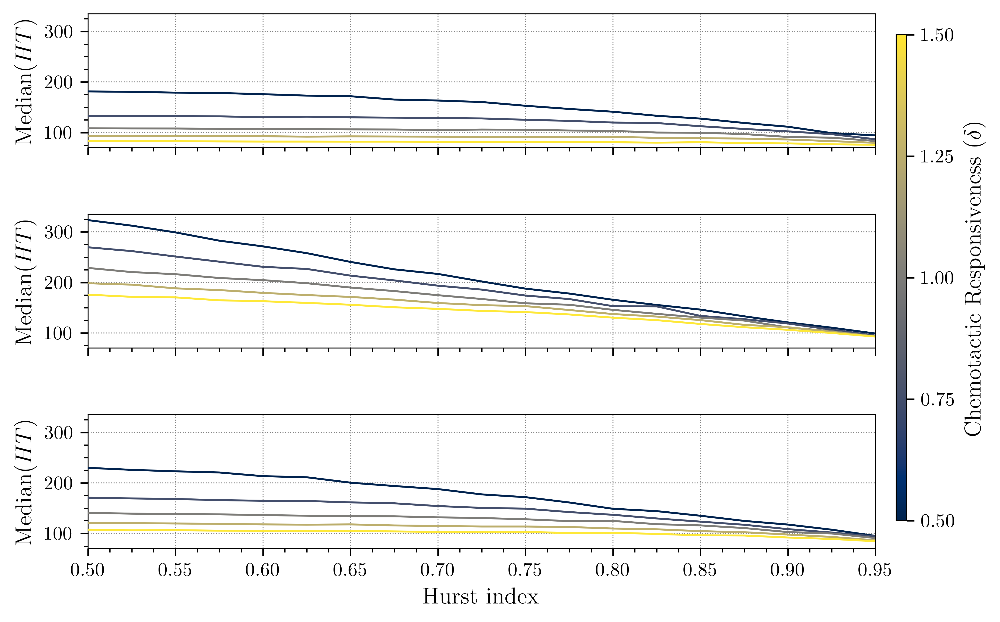

In [252]:
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)

folder = 'constant_h_wall_delta'

list_files = os.listdir(folder)
delta_values = [0.5, 0.75, 1, 1.25, 1.5]



norm = mcolors.Normalize(vmin=min(delta_values), vmax= max(delta_values))
cmap = plt.cm.cividis
dict_values_plot = {d: [] for d in delta_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        
        dict_values_plot[delta].append((h, moment))

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
    
#----------- Linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)

dict_values_plot = {d: [] for d in delta_values} # each item is a tuple of the moment and wall
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        
        dict_values_plot[delta].append((h, moment))
    
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['H'], df_val['Moment'],
                      linewidth = 1,
                      color = cmap(norm(key)), zorder = 3 + key)
        
        
# ----------- Exponential

folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {d: [] for d in delta_values} # each item is a tuple of the moment and wall
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        
        dict_values_plot[delta].append((h, moment))

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['H'], df_val['Moment'],
                            linewidth = 1,
                            color = cmap(norm(key)), zorder = 3 + key)


# --- X axis

ax['Constant'].set_xticks([0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95])
ax['Exponential'].set_xlabel('Hurst index', fontsize = 12)
ax['Constant'].set_xlim([0.5, 0.95])
# --- Y axis
c_ylim = ax['Constant'].get_ylim()
l_ylim = ax['Linear'].get_ylim()
e_ylim = ax['Exponential'].get_ylim()


# ax['Constant'].set_yscale('log')
# ax['Linear'].set_yscale('log')
# ax['Exponential'].set_yscale('log')

ylims = [np.min([c_ylim[0], l_ylim[0], e_ylim[0]]), np.max([c_ylim[1], l_ylim[1], e_ylim[1]])]
ax['Constant'].set_ylim(ylims)
ax['Linear'].set_ylim(ylims)
ax['Exponential'].set_ylim(ylims)

ax['Constant'].set_ylabel(r'Median($HT$)', fontsize = 12)
ax['Linear'].set_ylabel(r'Median($HT$)', fontsize = 12)
ax['Exponential'].set_ylabel(r'Median($HT$)', fontsize = 12)

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    


fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_ticks(delta_values)
cbar.set_label(r"Chemotactic Responsiveness $(\delta)$", fontsize = 12)

os.makedirs('figures/CharacterizationPlots', exist_ok=True)
fig.savefig('figures/CharacterizationPlots/Median_x_hurst_color_delta.pdf', transparent=True, bbox_inches='tight')

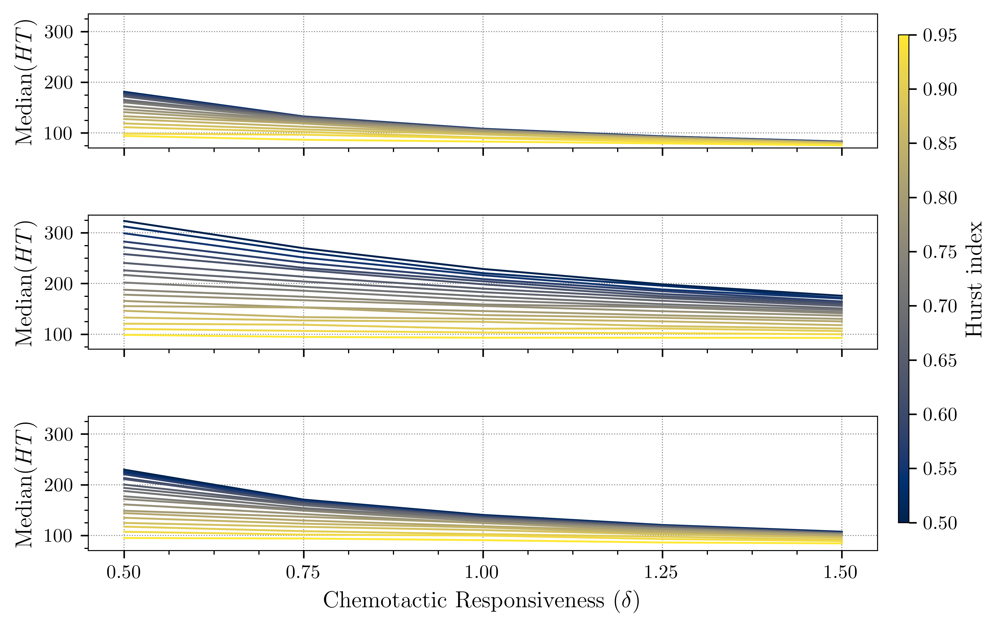

In [253]:
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)

folder = 'constant_h_wall_delta'

list_files = os.listdir(folder)




dict_values_plot = {} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((delta, moment))

h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['delta', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'delta', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['delta'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    

    
    
#----------- Linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)

dict_values_plot = {} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((delta, moment))

h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['delta', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'delta', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['delta'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
        
# ----------- Exponential

folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {} # each item is a tuple of the moment and wall
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = np.median(df.to_numpy())
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((delta, moment))

h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['delta', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'delta', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['delta'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    

# --- X axis

ax['Constant'].set_xticks([0.5, 0.75, 1, 1.25, 1.5])    

ax['Exponential'].set_xlabel(r"Chemotactic Responsiveness $(\delta)$", fontsize = 12)

# --- Y axis
c_ylim = ax['Constant'].get_ylim()
l_ylim = ax['Linear'].get_ylim()
e_ylim = ax['Exponential'].get_ylim()


# ax['Constant'].set_yscale('log')
# ax['Linear'].set_yscale('log')
# ax['Exponential'].set_yscale('log')

ylims = [np.min([c_ylim[0], l_ylim[0], e_ylim[0]]), np.max([c_ylim[1], l_ylim[1], e_ylim[1]])]
ax['Constant'].set_ylim(ylims)
ax['Linear'].set_ylim(ylims)
ax['Exponential'].set_ylim(ylims)

ax['Constant'].set_ylabel(r'Median($HT$)', fontsize = 12)
ax['Linear'].set_ylabel(r'Median($HT$)', fontsize = 12)
ax['Exponential'].set_ylabel(r'Median($HT$)', fontsize = 12)

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    


fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label(r"Hurst index", fontsize = 12)

os.makedirs('figures/CharacterizationPlots', exist_ok=True)
fig.savefig('figures/CharacterizationPlots/Median_x_delta_color_hurst.pdf', transparent=True, bbox_inches='tight')

## Mode w.r.t. Hurst at delta change

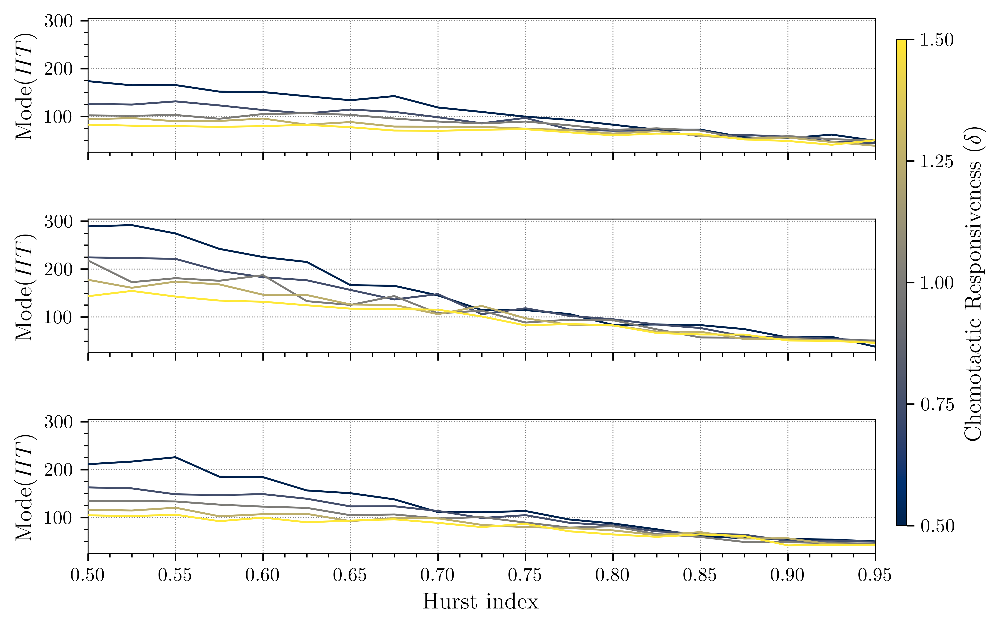

In [254]:
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker


def get_maximum(dist):
    hist_1, bin_edges_1 = np.histogram(dist, bins='auto', density=True)
    bin_centers_1 = 0.5 * (bin_edges_1[1:] + bin_edges_1[:-1])
    max_ind = np.argmax(hist_1)
    
    return bin_centers_1[max_ind], hist_1[max_ind]

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)

folder = 'constant_h_wall_delta'

list_files = os.listdir(folder)
delta_values = [0.5, 0.75, 1, 1.25, 1.5]



norm = mcolors.Normalize(vmin=min(delta_values), vmax= max(delta_values))
cmap = plt.cm.cividis
dict_values_plot = {d: [] for d in delta_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        
        dict_values_plot[delta].append((h, moment))

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
    
#----------- Linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)

dict_values_plot = {d: [] for d in delta_values} # each item is a tuple of the moment and wall
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        
        dict_values_plot[delta].append((h, moment))
    
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['H'], df_val['Moment'],
                      linewidth = 1,
                      color = cmap(norm(key)), zorder = 3 + key)
        
        
# ----------- Exponential

folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {d: [] for d in delta_values} # each item is a tuple of the moment and wall
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        
        dict_values_plot[delta].append((h, moment))

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['H'], df_val['Moment'],
                            linewidth = 1,
                            color = cmap(norm(key)), zorder = 3 + key)


# --- X axis

ax['Constant'].set_xticks([0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95])
ax['Exponential'].set_xlabel('Hurst index', fontsize = 12)
ax['Constant'].set_xlim([0.5, 0.95])
# --- Y axis
c_ylim = ax['Constant'].get_ylim()
l_ylim = ax['Linear'].get_ylim()
e_ylim = ax['Exponential'].get_ylim()


# ax['Constant'].set_yscale('log')
# ax['Linear'].set_yscale('log')
# ax['Exponential'].set_yscale('log')

ylims = [np.min([c_ylim[0], l_ylim[0], e_ylim[0]]), np.max([c_ylim[1], l_ylim[1], e_ylim[1]])]
ax['Constant'].set_ylim(ylims)
ax['Linear'].set_ylim(ylims)
ax['Exponential'].set_ylim(ylims)

ax['Constant'].set_ylabel(r'Mode($HT$)', fontsize = 12)
ax['Linear'].set_ylabel(r'Mode($HT$)', fontsize = 12)
ax['Exponential'].set_ylabel(r'Mode($HT$)', fontsize = 12)

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    


fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_ticks(delta_values)
cbar.set_label(r"Chemotactic Responsiveness $(\delta)$", fontsize = 12)

os.makedirs('figures/CharacterizationPlots', exist_ok=True)
fig.savefig('figures/CharacterizationPlots/Mode_x_hurst_color_delta.pdf', transparent=True, bbox_inches='tight')

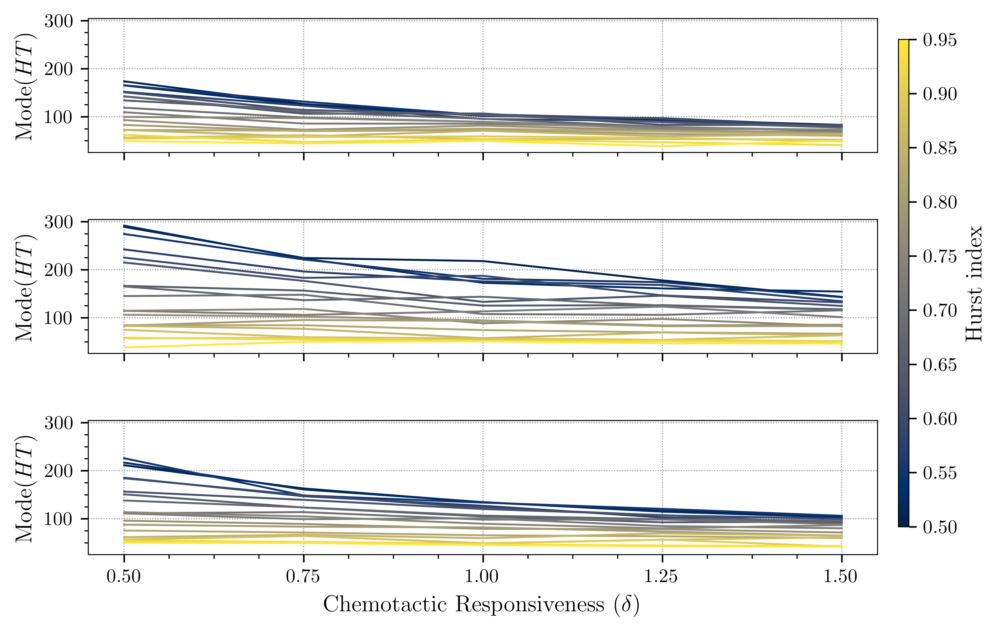

In [255]:
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
def get_maximum(dist):
    hist_1, bin_edges_1 = np.histogram(dist, bins='auto', density=True)
    bin_centers_1 = 0.5 * (bin_edges_1[1:] + bin_edges_1[:-1])
    max_ind = np.argmax(hist_1)
    
    return bin_centers_1[max_ind], hist_1[max_ind]
#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 10,

    "ytick.labelsize": 10,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 4,
    "ytick.major.size": 4,
    "xtick.minor.size": 2,
    "ytick.minor.size": 2,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)

folder = 'constant_h_wall_delta'

list_files = os.listdir(folder)




dict_values_plot = {} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((delta, moment))

h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['delta', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'delta', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['delta'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    

    
    
#----------- Linear
folder = 'linear_h_wall_delta'
list_files = os.listdir(folder)

dict_values_plot = {} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((delta, moment))

h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['delta', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'delta', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['delta'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
        
# ----------- Exponential

folder = 'exponential_h_wall_delta'
list_files = os.listdir(folder)
dict_values_plot = {} # each item is a tuple of the moment and wall
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    delta = float(archiv2[2].split('_')[1])
    if wall == 50:
        df = pd.read_csv(join(folder, archiv)).dropna()
        moment = get_maximum(df.to_numpy())[0]
        if h not in dict_values_plot.keys():
            dict_values_plot[h] = []
        dict_values_plot[h].append((delta, moment))

h_values = list(dict_values_plot.keys())
norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis


for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['delta', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'delta', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['delta'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    

# --- X axis

ax['Constant'].set_xticks([0.5, 0.75, 1, 1.25, 1.5])    

ax['Exponential'].set_xlabel(r"Chemotactic Responsiveness $(\delta)$", fontsize = 12)

# --- Y axis
c_ylim = ax['Constant'].get_ylim()
l_ylim = ax['Linear'].get_ylim()
e_ylim = ax['Exponential'].get_ylim()


# ax['Constant'].set_yscale('log')
# ax['Linear'].set_yscale('log')
# ax['Exponential'].set_yscale('log')

ylims = [np.min([c_ylim[0], l_ylim[0], e_ylim[0]]), np.max([c_ylim[1], l_ylim[1], e_ylim[1]])]
ax['Constant'].set_ylim(ylims)
ax['Linear'].set_ylim(ylims)
ax['Exponential'].set_ylim(ylims)

ax['Constant'].set_ylabel(r'Mode($HT$)', fontsize = 12)
ax['Linear'].set_ylabel(r'Mode($HT$)', fontsize = 12)
ax['Exponential'].set_ylabel(r'Mode($HT$)', fontsize = 12)

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(4))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(4))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    


fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label(r"Hurst index", fontsize = 12)

os.makedirs('figures/CharacterizationPlots', exist_ok=True)
fig.savefig('figures/CharacterizationPlots/Mode_x_delta_color_hurst.pdf', transparent=True, bbox_inches='tight')

# Other figures

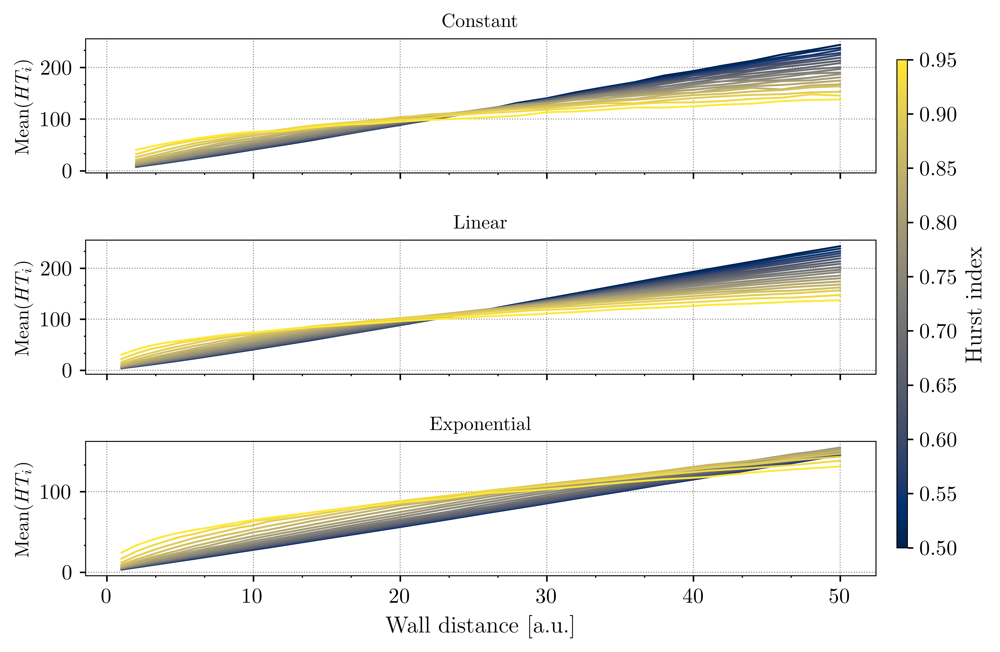

In [ ]:
### Moments plot first moment

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

### Constant
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 11,

    "ytick.labelsize": 11,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 3,
    "ytick.major.size": 3,
    "xtick.minor.size": 1,
    "ytick.minor.size": 1,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    return jensenshannon(p, q)**2


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)



# constant
folder = 'constant_h_wall_delta'
list_files = os.listdir(folder)



h_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    if h not in h_values:
        h_values.append(h)




norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis
dict_values_plot = {h: [] for h in h_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    delta = np.round(float(archiv2[2].split('_')[1]),3)
    if delta == 1:
        if wall >= 1:
            dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
            dist = dist[dist<499.999]
            
            # Calculate first moment
            moment = np.mean(dist)
            dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
        
        
# linear
folder = 'linear_h_wall_cluster'
list_files = os.listdir(folder)
dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = np.mean(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
        
# exponential
folder = 'exponential_h_wall_cluster'
list_files = os.listdir(folder)

dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = np.mean(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)

# # X-axis 

ax['Exponential'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# Y-axis
ax['Constant'].set_ylabel(r'$\mathrm{Mean}(HT_i)$', fontsize = 10)
ax['Linear'].set_ylabel(r'$\mathrm{Mean}(HT_i)$', fontsize = 10)
ax['Exponential'].set_ylabel(r'$\mathrm{Mean}(HT_i)$', fontsize = 10)

# titles
ax['Constant'].set_title(r'Constant', fontsize = 10)
ax['Linear'].set_title(r'Linear', fontsize = 10)
ax['Exponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    
# fig.savefig(join('figures', 'hitting_time_distribution_first_moment.pdf'), dpi=600, bbox_inches='tight')



44.355
4.578
70.5
10.671
19.723
83.933
3.134
21.064
93.016
4.804
25.946
73.524
32.263
73.58800000000001
17.984
12.359
8.898
6.854
11.931
40.56
50.77
89.435
3.093
31.808
8.518
64.784
3.139
15.837
57.283
6.86
4.394
60.932
29.883
3.225
13.327
72.274
22.201
5.057
4.849
3.499
15.73
16.4
47.699
2.938
58.747
3.794
88.825
63.387
12.329
54.159
35.028
78.805
30.079
9.332
19.11
4.135
68.112
47.762
97.474
91.988
42.573
16.971
4.993
16.154
83.852
19.876
56.126
43.109
11.086
10.194
6.327
52.712
4.735
20.518
42.806
57.129
19.401
13.925
17.816
4.002
4.533
36.627
16.232
74.569
3.723
25.517
74.678
51.214
19.469
42.302
16.715
76.105
36.633
18.452
9.547
17.492
49.693
98.5
12.538
52.827
7.196
5.796
55.925
32.231
52.692
16.629
1.497
81.95
26.041
35.924
3.248
46.981
6.248
9.794
8.82
6.168
65.488
2.206
18.535
40.629
3.162
2.746
10.593
49.124
11.847
30.176
47.267
12.595
69.351
3.158
41.317
7.148000000000001
10.893
9.929
22.429
4.282
42.213
8.053
67.291
3.185
9.627
38.815
68.858
91.715
37.5
3.927
43.935
1.413
2

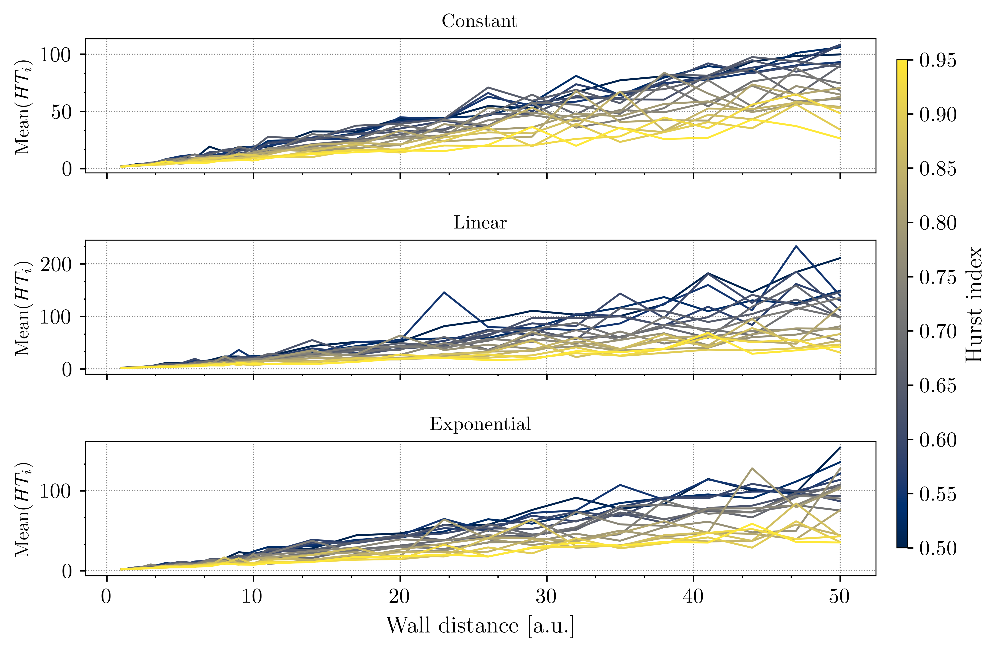

In [ ]:
### Moments plot first moment

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

### Constant
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon
from scipy.stats import mode

#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 11,

    "ytick.labelsize": 11,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 3,
    "ytick.major.size": 3,
    "xtick.minor.size": 1,
    "ytick.minor.size": 1,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    return jensenshannon(p, q)**2


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)



# constant
folder = 'constant_h_wall_cluster'
list_files = os.listdir(folder)



h_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    if h not in h_values:
        h_values.append(h)




norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis
dict_values_plot = {h: [] for h in h_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = mode(dist)[0]
        print(moment)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
        
        
# linear
folder = 'linear_h_wall_cluster'
list_files = os.listdir(folder)
dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = mode(dist)[0]
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
        
# exponential
folder = 'exponential_h_wall_cluster'
list_files = os.listdir(folder)

dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = mode(dist)[0]
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)

# # X-axis 

ax['Exponential'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# Y-axis
ax['Constant'].set_ylabel(r'$\mathrm{Mean}(HT_i)$', fontsize = 10)
ax['Linear'].set_ylabel(r'$\mathrm{Mean}(HT_i)$', fontsize = 10)
ax['Exponential'].set_ylabel(r'$\mathrm{Mean}(HT_i)$', fontsize = 10)

# titles
ax['Constant'].set_title(r'Constant', fontsize = 10)
ax['Linear'].set_title(r'Linear', fontsize = 10)
ax['Exponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    
# fig.savefig(joi
# n('figures', 'hitting_time_distribution_first_moment.pdf'), dpi=600, bbox_inches='tight')



/Users/gabrielmiranda/micromamba/envs/SaaLab/lib/python3.9/site-packages/IPython/core/events.py:82: UserWarning: AutoMinorLocator does not work on logarithmic scales
  func(*args, **kwargs)
/Users/gabrielmiranda/micromamba/envs/SaaLab/lib/python3.9/site-packages/IPython/core/pylabtools.py:152: UserWarning: AutoMinorLocator does not work on logarithmic scales
  fig.canvas.print_figure(bytes_io, **kw)


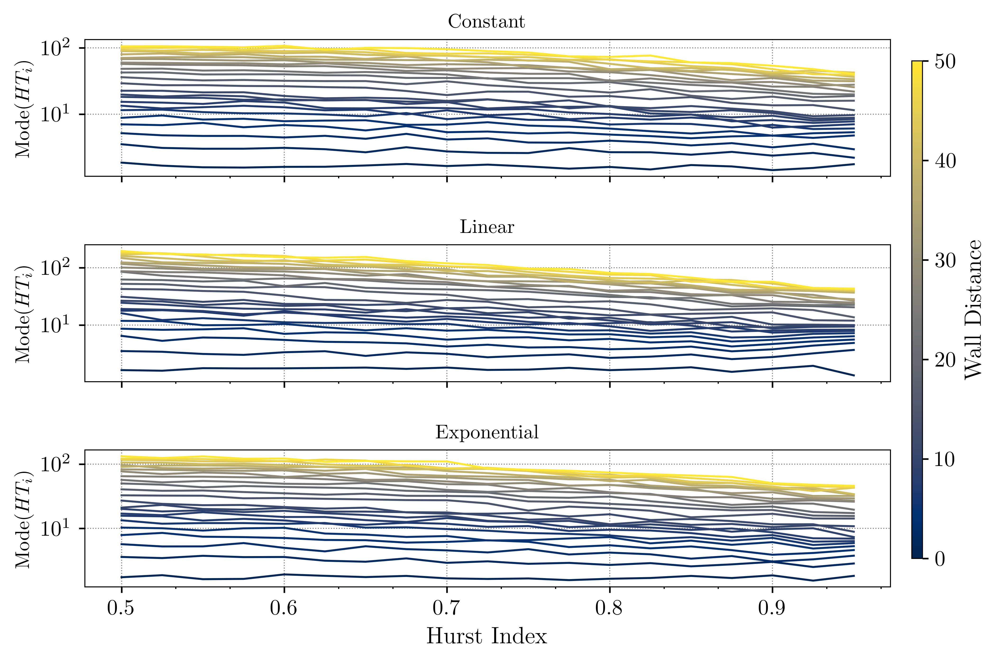

In [147]:
### Moments plot first moment

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

### Constant
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon
from scipy.stats import mode
from scipy.signal import savgol_filter
#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 11,

    "ytick.labelsize": 11,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 3,
    "ytick.major.size": 3,
    "xtick.minor.size": 1,
    "ytick.minor.size": 1,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})


def get_maximum(dist):
    hist_1, bin_edges_1 = np.histogram(dist, bins='auto', density=True)
    bin_centers_1 = 0.5 * (bin_edges_1[1:] + bin_edges_1[:-1])
    max_ind = np.argmax(hist_1)
    
    return bin_centers_1[max_ind], hist_1[max_ind]


def js_divergence(p, q):
    return jensenshannon(p, q)**2


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)



# constant
folder = 'constant_h_wall_cluster'
list_files = os.listdir(folder)



wall_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    if wall not in wall_values:
        wall_values.append(wall)




norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis
dict_values_plot = {wall: [] for wall in wall_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]

        # Calculate first moment
        moment = get_maximum(dist)[0]
        # print(moment)
        dict_values_plot[wall].append([h, moment])

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)




# linear
folder = 'linear_h_wall_cluster'
list_files = os.listdir(folder)
dict_values_plot = {wall: [] for wall in wall_values}

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]

        # Calculate first moment
        moment = get_maximum(dist)[0]
        dict_values_plot[wall].append([h, moment])

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)

# exponential
folder = 'exponential_h_wall_cluster'
list_files = os.listdir(folder)

dict_values_plot = dict_values_plot = {wall: [] for wall in wall_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]

        # Calculate first moment
        moment = get_maximum(dist)[0]
        dict_values_plot[wall].append([h, moment])

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)

# # X-axis

ax['Exponential'].set_xlabel('Hurst Index', fontsize = 12)

# Y-axis
ax['Constant'].set_ylabel(r'$\mathrm{Mode}(HT_i)$', fontsize = 10)
ax['Linear'].set_ylabel(r'$\mathrm{Mode}(HT_i)$', fontsize = 10)
ax['Exponential'].set_ylabel(r'$\mathrm{Mode}(HT_i)$', fontsize = 10)

ax['Constant'].set_yscale('log')
ax['Linear'].set_yscale('log')
ax['Exponential'].set_yscale('log')
# titles
ax['Constant'].set_title(r'Constant', fontsize = 10)
ax['Linear'].set_title(r'Linear', fontsize = 10)
ax['Exponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Wall Distance")

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)

# fig.savefig(joi
# n('figures', 'hitting_time_distribution_first_moment.pdf'), dpi=600, bbox_inches='tight')



/Users/gabrielmiranda/micromamba/envs/SaaLab/lib/python3.9/site-packages/IPython/core/events.py:82: UserWarning: AutoMinorLocator does not work on logarithmic scales
  func(*args, **kwargs)
/Users/gabrielmiranda/micromamba/envs/SaaLab/lib/python3.9/site-packages/IPython/core/pylabtools.py:152: UserWarning: AutoMinorLocator does not work on logarithmic scales
  fig.canvas.print_figure(bytes_io, **kw)


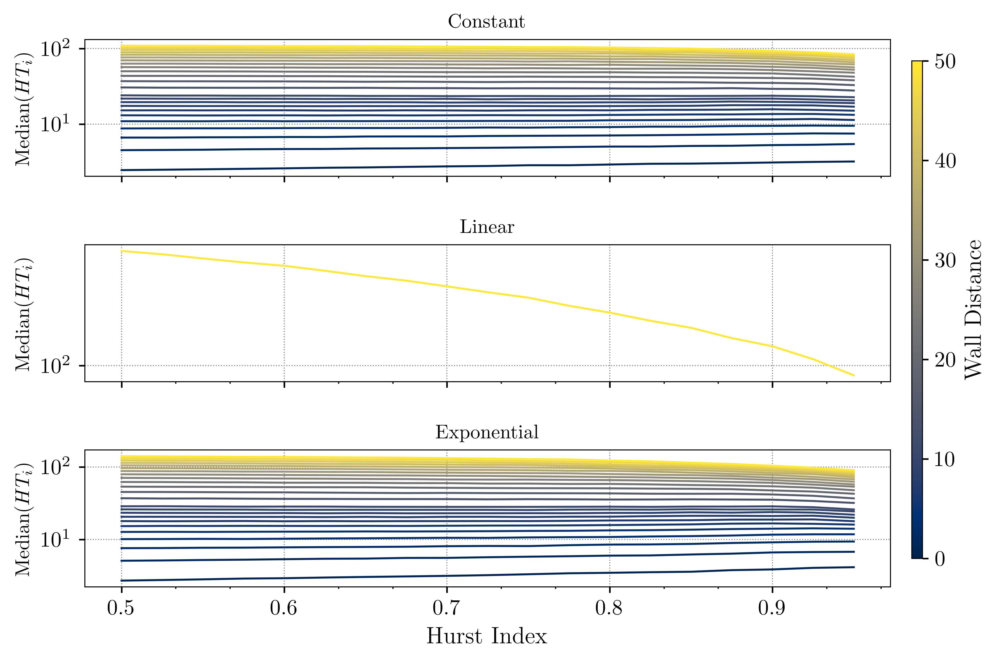

In [150]:
### Moments plot first moment

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

### Constant
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon
from scipy.stats import mode
from scipy.signal import savgol_filter
#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 11,

    "ytick.labelsize": 11,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 3,
    "ytick.major.size": 3,
    "xtick.minor.size": 1,
    "ytick.minor.size": 1,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

def get_maximum(dist):
    hist_1, bin_edges_1 = np.histogram(dist, bins='auto', density=True)
    bin_centers_1 = 0.5 * (bin_edges_1[1:] + bin_edges_1[:-1])
    # Smooth the histogram using Savitzky-Golay filter
    smoothed_hist_1 = savgol_filter(hist_1, window_length=5, polyorder=3)
    # Find the index of the maximum value in the smoothed histogram
    max_ind = np.argmax(smoothed_hist_1)
    return bin_centers_1[max_ind]




def js_divergence(p, q):
    return jensenshannon(p, q)**2


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)



# constant
folder = 'constant_h_wall_cluster'
list_files = os.listdir(folder)



wall_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    if wall not in wall_values:
        wall_values.append(wall)




norm = mcolors.Normalize(vmin=min(wall_values), vmax= max(wall_values))
cmap = plt.cm.cividis
dict_values_plot = {wall: [] for wall in wall_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]

        # Calculate first moment
        moment = np.median(dist)
        # print(moment)
        dict_values_plot[wall].append([h, moment])

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)




# linear
folder = 'linear_h_wall_cluster'
list_files = os.listdir(folder)
dict_values_plot = {wall: [] for wall in wall_values}

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]

        # Calculate first moment
        moment = np.median(dist)
        dict_values_plot[wall].append([h, moment])

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    # ax['Linear'].plot(df_val['H'], df_val['Moment'],
    #                     linewidth = 1,
    #                     color = cmap(norm(key)), zorder = 3 + key)
    # break
    if key == 50:
        ax['Linear'].plot(df_val['H'], df_val['Moment'],
                            linewidth = 1,
                            color = cmap(norm(key)), zorder = 3 + key)

# exponential
folder = 'exponential_h_wall_cluster'
list_files = os.listdir(folder)

dict_values_plot = dict_values_plot = {wall: [] for wall in wall_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]

        # Calculate first moment
        moment = np.median(dist)
        dict_values_plot[wall].append([h, moment])

for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['H', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'H', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['H'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    

# # X-axis

ax['Exponential'].set_xlabel('Hurst Index', fontsize = 12)

# Y-axis
ax['Constant'].set_ylabel(r'$\mathrm{Median}(HT_i)$', fontsize = 10)
ax['Linear'].set_ylabel(r'$\mathrm{Median}(HT_i)$', fontsize = 10)
ax['Exponential'].set_ylabel(r'$\mathrm{Median}(HT_i)$', fontsize = 10)

ax['Constant'].set_yscale('log')
ax['Linear'].set_yscale('log')
ax['Exponential'].set_yscale('log')
# titles
ax['Constant'].set_title(r'Constant', fontsize = 10)
ax['Linear'].set_title(r'Linear', fontsize = 10)
ax['Exponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Wall Distance")

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)

# fig.savefig(joi
# n('figures', 'hitting_time_distribution_first_moment.pdf'), dpi=600, bbox_inches='tight')


In [69]:
dist = pd.read_csv('constant_h_wall_delta/h_0.95__wall_50__delta_1.csv')

In [70]:
dist

,Hitting Time
0,NaN
1,NaN
2,51.9
3,285.1
4,64.5
...,...
9995,45.4
9996,102.3
9997,119.6
9998,42.6


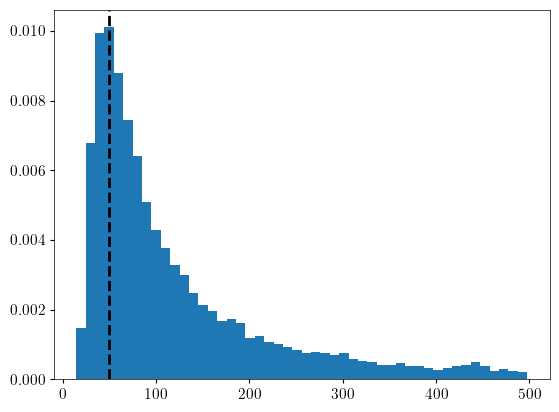

In [71]:
from scipy.signal import savgol_filter, find_peaks
def get_maximum(dist):
    hist_1, bin_edges_1 = np.histogram(dist, bins='auto', density=True)
    bin_centers_1 = 0.5 * (bin_edges_1[1:] + bin_edges_1[:-1])
    # Smooth the histogram using Savitzky-Golay filter
    smoothed_hist_1 = savgol_filter(hist_1, window_length=5, polyorder=3)
    # Find the index of the maximum value in the smoothed histogram
    max_ind = np.argmax(smoothed_hist_1)
    return bin_centers_1[max_ind]
    
    
    
plt.hist(dist, bins='auto', density=True)
max_dist = get_maximum(dist.dropna())
plt.axvline(x=max_dist, color='k', linestyle='--')

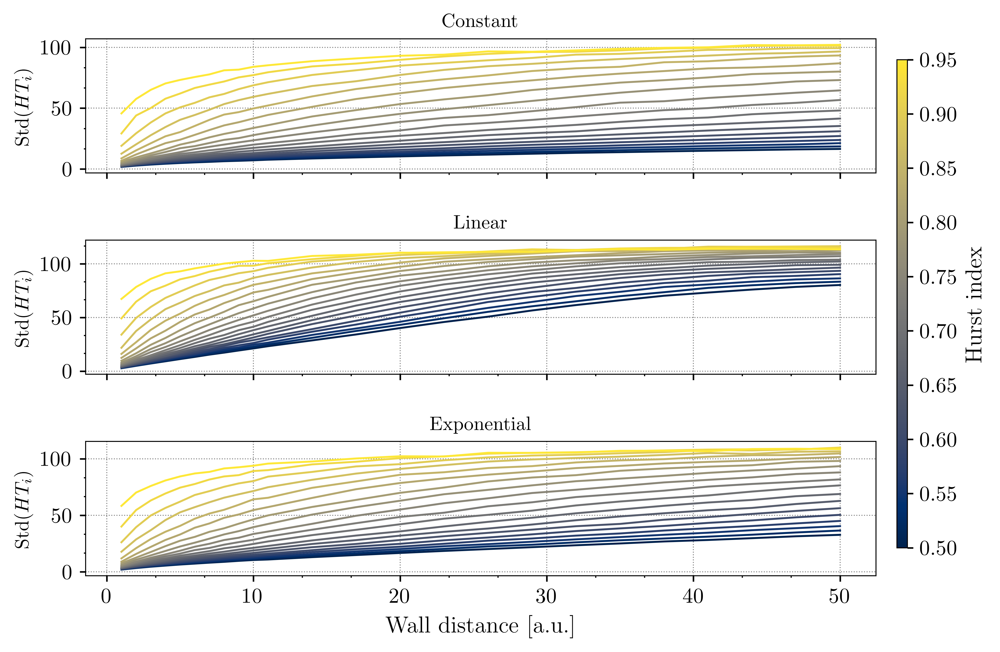

In [19]:
### Moments plot first moment

import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker

### Constant
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.spatial.distance import jensenshannon


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 11,

    "ytick.labelsize": 11,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 3,
    "ytick.major.size": 3,
    "xtick.minor.size": 1,
    "ytick.minor.size": 1,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    return jensenshannon(p, q)**2


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)




# constant
folder = 'constant_h_wall_cluster'
list_files = os.listdir(folder)



h_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    if h not in h_values:
        h_values.append(h)




norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis
dict_values_plot = {h: [] for h in h_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = np.std(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
        
        
# linear
folder = 'linear_h_wall_cluster'
list_files = os.listdir(folder)
dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = np.std(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
        
# exponential
folder = 'exponential_h_wall_cluster'
list_files = os.listdir(folder)

dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = np.std(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)

# # X-axis 

ax['Exponential'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# Y-axis
ax['Constant'].set_ylabel(r'$\mathrm{Std}(HT_i)$', fontsize = 10)
ax['Linear'].set_ylabel(r'$\mathrm{Std}(HT_i)$', fontsize = 10)
ax['Exponential'].set_ylabel(r'$\mathrm{Std}(HT_i)$', fontsize = 10)

# titles
ax['Constant'].set_title(r'Constant', fontsize = 10)
ax['Linear'].set_title(r'Linear', fontsize = 10)
ax['Exponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    
fig.savefig(join('figures', 'hitting_time_second_moment.pdf'), dpi=600, bbox_inches='tight')


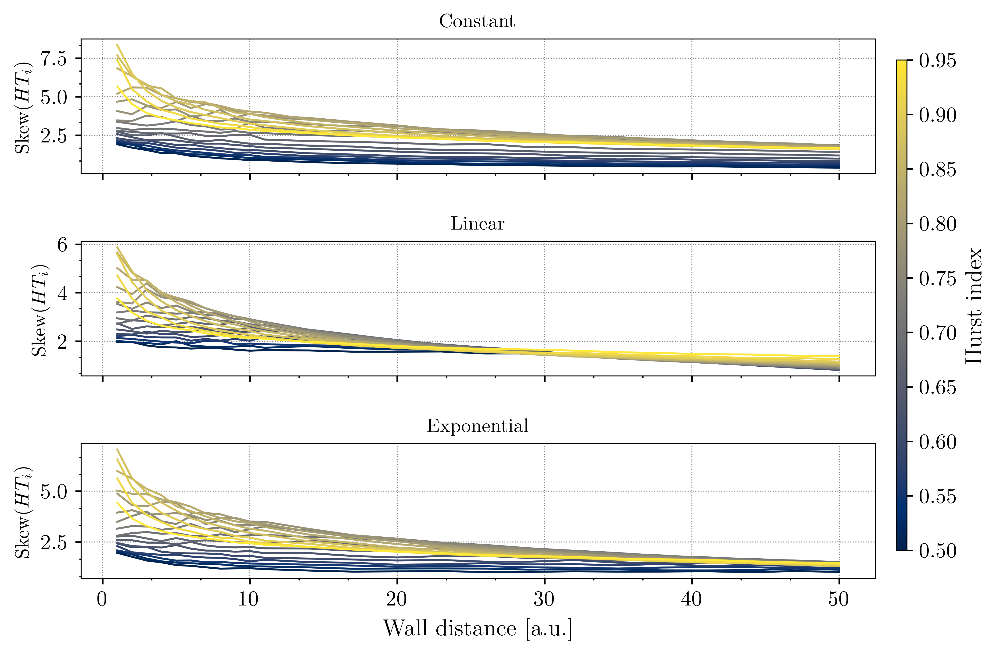

In [20]:


### Constant
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.stats import skew, kurtosis
from scipy.spatial.distance import jensenshannon


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 11,

    "ytick.labelsize": 11,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 3,
    "ytick.major.size": 3,
    "xtick.minor.size": 1,
    "ytick.minor.size": 1,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    return jensenshannon(p, q)**2


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)



# constant
folder = 'constant_h_wall_cluster'
list_files = os.listdir(folder)



h_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    if h not in h_values:
        h_values.append(h)




norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis
dict_values_plot = {h: [] for h in h_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate third moment
        moment = stats.skew(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
        
        
# linear
folder = 'linear_h_wall_cluster'
list_files = os.listdir(folder)
dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = stats.skew(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
        
# exponential
folder = 'exponential_h_wall_cluster'
list_files = os.listdir(folder)

dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate first moment
        moment = stats.skew(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)

# # X-axis 

ax['Exponential'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# Y-axis
ax['Constant'].set_ylabel(r'$\mathrm{Skew}(HT_i)$', fontsize = 10)
ax['Linear'].set_ylabel(r'$\mathrm{Skew}(HT_i)$', fontsize = 10)
ax['Exponential'].set_ylabel(r'$\mathrm{Skew}(HT_i)$', fontsize = 10)

# titles
ax['Constant'].set_title(r'Constant', fontsize = 10)
ax['Linear'].set_title(r'Linear', fontsize = 10)
ax['Exponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    
fig.savefig(join('figures', 'hitting_time_third_moment.pdf'), dpi=600, bbox_inches='tight')


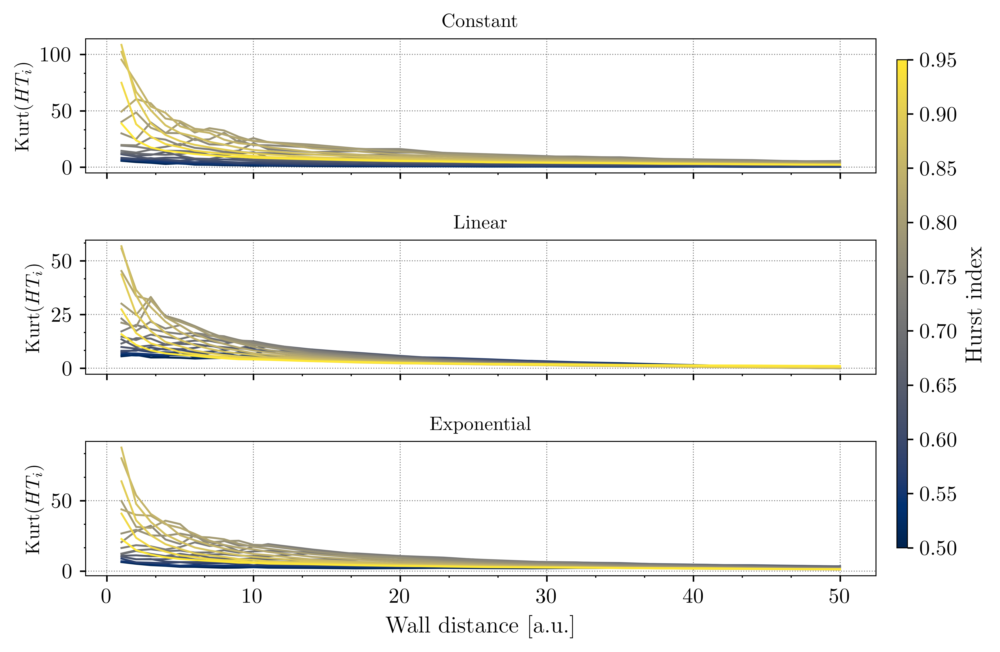

In [21]:


### Constant
### JS divergence plot between the distributions
import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker
from scipy.stats import skew, kurtosis
from scipy.spatial.distance import jensenshannon


#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 11,

    "ytick.labelsize": 11,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 3,
    "ytick.major.size": 3,
    "xtick.minor.size": 1,
    "ytick.minor.size": 1,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})



def js_divergence(p, q):
    return jensenshannon(p, q)**2


fig, ax = plt.subplot_mosaic(
    [['Constant'],
     ['Linear'],
     ['Exponential']],
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # sharey=True,
    gridspec_kw={"hspace": 0.5},
)



# constant
folder = 'constant_h_wall_cluster'
list_files = os.listdir(folder)



h_values = []
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall = int(float(archiv2[1].split('_')[1]))
    if h not in h_values:
        h_values.append(h)




norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis
dict_values_plot = {h: [] for h in h_values} # each item is a tuple of the moment and wall

for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate  moment
        moment = stats.kurtosis(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Constant'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
    
    
        
        
# linear
folder = 'linear_h_wall_cluster'
list_files = os.listdir(folder)
dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate  moment
        moment = stats.kurtosis(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Linear'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)
        
# exponential
folder = 'exponential_h_wall_cluster'
list_files = os.listdir(folder)

dict_values_plot = dict_values_plot = {h: [] for h in h_values}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = np.round(float(archiv2[0].split('_')[1]),3)
    wall =  int(float(archiv2[1].split('_')[1]))
    if wall >= 1:
        dist = pd.read_csv(join(folder, archiv)).to_numpy() # h != 0.5
        dist = dist[dist<499.999]
        
        # Calculate  moment
        moment = stats.kurtosis(dist)
        dict_values_plot[h].append([wall, moment])
        
for key,  value in dict_values_plot.items():
    df_val = pd.DataFrame(columns = ['Wall', 'Moment'])
    for i, tup in enumerate(value):
        df_val.loc[i, :] = tup[0], tup[1]
    df_val.sort_values(by = 'Wall', inplace=True)
    df_val.reset_index(inplace=True, drop = True)
    ax['Exponential'].plot(df_val['Wall'], df_val['Moment'],
                        linewidth = 1,
                        color = cmap(norm(key)), zorder = 3 + key)

# # X-axis 

ax['Exponential'].set_xlabel('Wall distance [a.u.]', fontsize = 12)

# Y-axis
ax['Constant'].set_ylabel(r'$\mathrm{Kurt}(HT_i)$', fontsize = 10)
ax['Linear'].set_ylabel(r'$\mathrm{Kurt}(HT_i)$', fontsize = 10)
ax['Exponential'].set_ylabel(r'$\mathrm{Kurt}(HT_i)$', fontsize = 10)

# titles
ax['Constant'].set_title(r'Constant', fontsize = 10)
ax['Linear'].set_title(r'Linear', fontsize = 10)
ax['Exponential'].set_title(r'Exponential', fontsize = 10)

### colorbar

fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# ticks
for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle=':', linewidth=0.5, zorder = 0)
    
fig.savefig(join('figures', 'hitting_time_fourth_moment.pdf'), dpi=600, bbox_inches='tight')


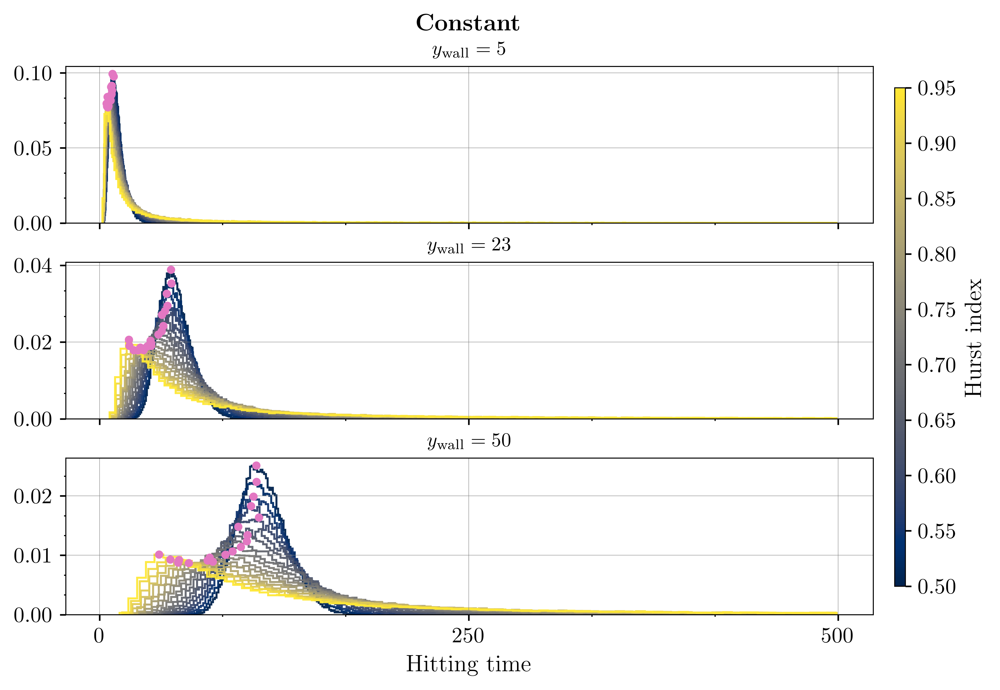

In [114]:
# 0.5 Consant


import os
import pandas as pd
import numpy as np
from os.path import join
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import ticker




#%% Plot contstant gradient
plt.rcParams.update({
    # Font and text
    "font.size": 12,
    "font.family": "serif",
    # "font.sans-serif": ["DejaVu Sans"],
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "legend.fontsize": 11,
    "xtick.labelsize": 11,

    "ytick.labelsize": 11,
    "text.usetex":True,
    # Axes and grid
    "axes.edgecolor": "black",
    "axes.linewidth": 0.5,
    "axes.grid": False,
    "grid.color": "lightgray",
    "grid.linestyle": "--",
    "grid.linewidth": 0.6,

    # Ticks
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 3,
    "ytick.major.size": 3,
    "xtick.minor.size": 1,
    "ytick.minor.size": 1,
    # Figure
    # "figure.figsize": (10, 6),
    # "figure.dpi": 100,
    # Lines
    "lines.linewidth": 2,
    "lines.markersize": 6,
    # Savefig
    "savefig.dpi": 600,
    "savefig.transparent": True,
})

fig, ax = plt.subplot_mosaic(
    [['Constant5'],
     ['Constant23'],
     ['Constant50']],
    # layout='constrained', 
    figsize=(7.5, 5), dpi=600,
    sharex=True,
    # gridspec_kw={"hspace": 0.5},
    # width_ratios=[1, 1, 1],
    height_ratios=[1, 1, 1],
    # sharey=True,
    gridspec_kw={"hspace": 0.25},
)

def get_maximum(dist):
    hist_1, bin_edges_1 = np.histogram(dist, bins='auto', density=True)
    bin_centers_1 = 0.5 * (bin_edges_1[1:] + bin_edges_1[:-1])
    max_ind = np.argmax(hist_1)
    
    return bin_centers_1[max_ind], hist_1[max_ind]



folder = 'constant_h_wall_cluster'
list_files = os.listdir(folder)
dict5 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    if wall == 5:
        if h not in dict5:
            dict5[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict5[h] = df.to_numpy()

dict23 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    if wall == 23:
        if h not in dict23:
            dict23[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict23[h] = df.to_numpy()

dict50 = {}
for archiv in list_files:
    archiv2 = archiv.strip('.csv.csv')
    archiv2 = archiv2.split('__')
    h = float(archiv2[0].split('_')[1])
    wall = float(archiv2[1].split('_')[1])
    if wall == 50:
        if h not in dict50:
            dict50[h] = None
        df = pd.read_csv(join(folder, archiv))
        dict50[h] = df.to_numpy()



h_values = sorted([x for x in list(dict5.keys()) if x != 0])
wall_values = [5, 23, 50]

norm = mcolors.Normalize(vmin=min(h_values), vmax= max(h_values))
cmap = plt.cm.cividis

# h05
c = 0
for h in h_values:
    df = dict5[h]
    df = df[df<499]
    max_dist, max_val = get_maximum(df)
    ax['Constant5'].scatter(max_dist, max_val, color = 'tab:pink', marker = 'o', s = 10, zorder = 2)
    
    ax['Constant5'].hist(df, bins='auto', density=True, alpha=0.95, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                         zorder  = 1, histtype='step')
    c += 1
c = 0
for h in h_values:
    df = dict23[h]
    df = df[df<499]
    max_dist, max_val = get_maximum(df)
    ax['Constant23'].scatter(max_dist, max_val, color = 'tab:pink', marker = 'o', s = 10, zorder = 2)
    
    ax['Constant23'].hist(df, bins='auto', density=True, alpha=0.95, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step')
    c += 1
    c += 1

c = 0
for h in h_values:
    df = dict50[h]
    df = df[df<499]
    

    max_dist, max_val = get_maximum(df)
    ax['Constant50'].scatter(max_dist, max_val, color = 'tab:pink', marker = 'o', s = 10, zorder = 2)
    
    
    ax['Constant50'].hist(df, bins='auto', density=True, alpha=0.95, label=f'Hurst Index = {h:.2f}', color=cmap(norm(h)),
                          zorder = 1, histtype='step')
    c += 1
    c += 1

# ----------- Color bar

### Color bar
fig.subplots_adjust(right=0.88)  # Leave space for colorbar
cbar_ax = fig.add_axes([0.90, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Hurst index")

# X-axis
ax['Constant5'].set_xticks([0,250, 500])
ax['Constant50'].set_xlabel('Hitting time', fontsize=12)
# ax['Linear50'].set_xlabel('Hitting time', fontsize=12)
# ax['Exponential50'].set_xlabel('Hitting time', fontsize=12)

# Y-axis
y_limc5 = ax['Constant5'].get_ylim()
y_limc23 = ax['Constant23'].get_ylim()
y_limc50 = ax['Constant50'].get_ylim()
ax['Constant5'].set_ylim(y_limc5)
# ax['Linear23'].set_ylim(y_limc23)
# ax['Linear50'].set_ylim(y_limc50)
# ax['Linear5'].set_ylim(y_limc5)
# ax['Exponential23'].set_ylim(y_limc23)
# ax['Exponential50'].set_ylim(y_limc50)
# # eliminate the y axis
# ax['Linear5'].set_yticklabels([])
# ax['Exponential5'].set_yticklabels([])
# ax['Linear23'].set_yticklabels([])
# ax['Exponential23'].set_yticklabels([])
# ax['Linear50'].set_yticklabels([])
# ax['Exponential50'].set_yticklabels([])



# Titles
ax['Constant5'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
ax['Constant23'].set_title(r'$y_{\mathrm{wall}} = 23$', fontsize = 10)
ax['Constant50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Linear5'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Linear23'].set_title(r'$y_{\mathrm{wall}} = 23$', fontsize = 10)
# ax['Linear50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)
# ax['Exponential5'].set_title(r'$y_{\mathrm{wall}} = 5$', fontsize = 10)
# ax['Exponential23'].set_title(r'$y_{\mathrm{wall}} = 23$', fontsize = 10)
# ax['Exponential50'].set_title(r'$y_{\mathrm{wall}} = 50$', fontsize = 10)

# labels

ax['Constant5'].annotate(
    r'\textbf{Constant}',
    xy = (0.5, 1.2), xycoords='axes fraction',
    ha='center', va='bottom',
    fontsize=12
)

# ax['Linear5'].annotate(
#     r'\textbf{Linear}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )

# ax['Exponential5'].annotate(
#     r'\textbf{Exponential}',
#     xy = (0.5, 1.2), xycoords='axes fraction',
#     ha='center', va='bottom',
#     fontsize=12
# )
# ax['Constant5'].set_xlim(50, 150)




for a in ax.values():
    a.xaxis.set_minor_locator(ticker.AutoMinorLocator(3))  # 3 minor ticks per major
    a.yaxis.set_minor_locator(ticker.AutoMinorLocator(3))
    a.grid(which='major', color='gray', linestyle='-', linewidth=0.2, zorder = 0)